# Author: Midrar Adham
## Corner Reliability & project Proposal

In [141]:
import os
import sys
import random
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt
from pprint import pprint as pp
import matplotlib.ticker as ticker

**Select a set of 5-10 images. Convert them to grayscale and show them**
---

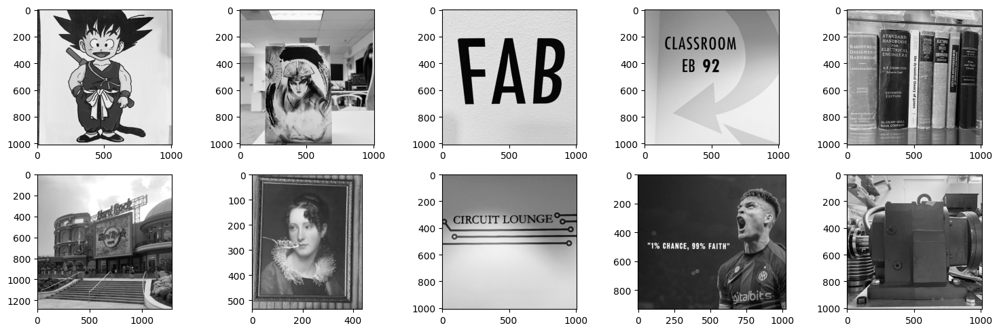

In [142]:
# dir = '../../sample_data/hw6_images_2/'
dir = '../../sample_data/new/'
images = os.listdir(dir)

_, ax = plt.subplots(2, 5, figsize=(15, 5))
ax = ax.flatten()
for img, ax in zip(images, ax):
    img = cv.imread(dir + img, cv.IMREAD_GRAYSCALE)
    ax.imshow(img, cmap='gray')

plt.tight_layout()



**Develop a means of transforming images using a perspective transform such that if the image were taken 5 meters away, the transformed image is taken with an equivalent of a camera location that has changed position according to a 3D gaussian distribution with a standard deviation of 1 meter and has changed its orientation by rotation along a random axis by an angle randomly chosen from a uniform distribution ranging from 0 to 10 degrees. Also randomly alter the scale of the image intensity with a uniform distribution of 0.95 to 1.05 and the brightness by -0.10 to 0.10. Show a selection of 10 examples of randomly selected images before and after the transform.**
---

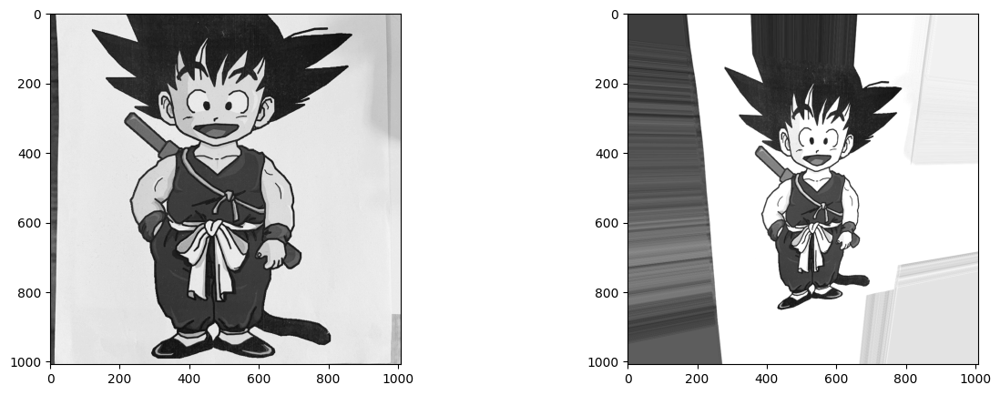

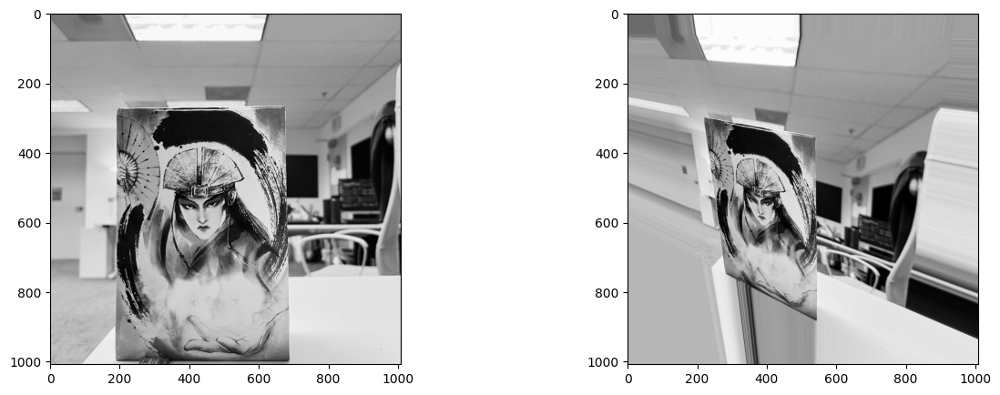

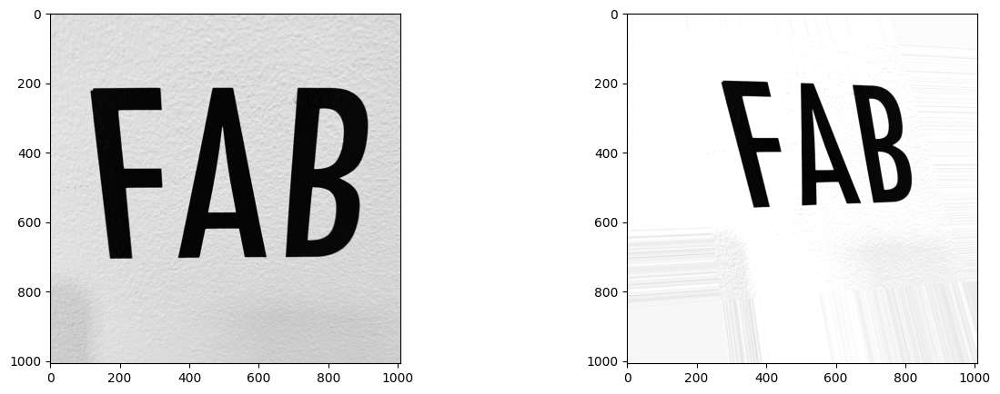

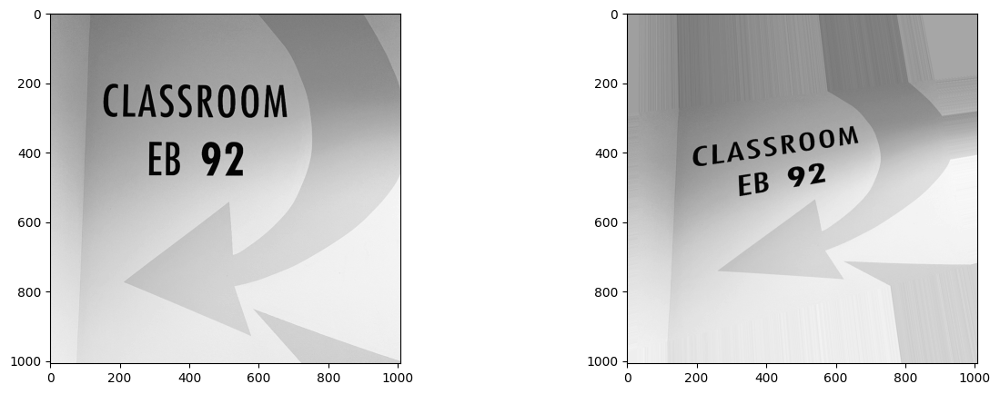

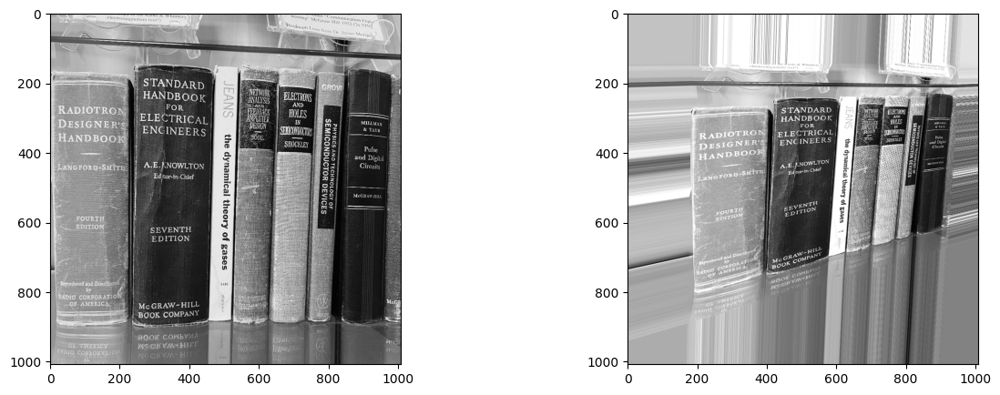

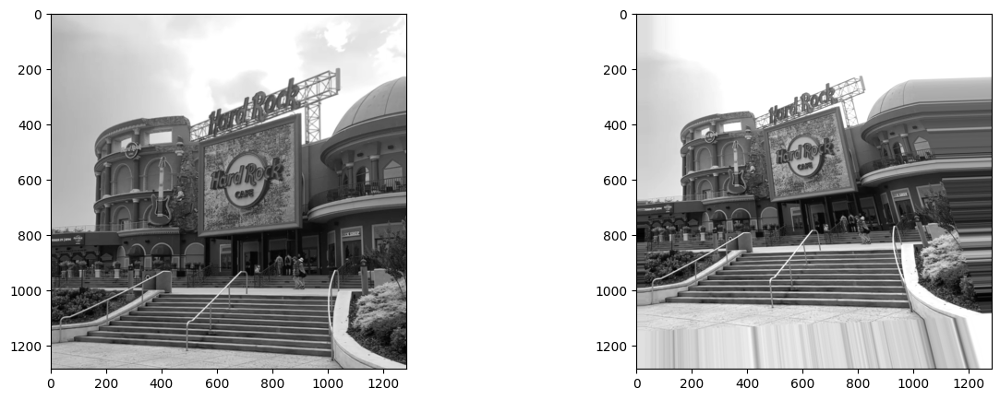

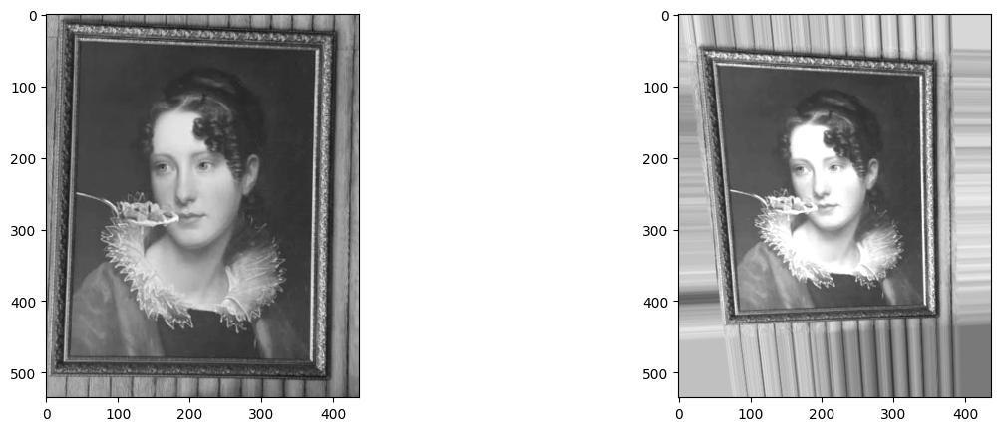

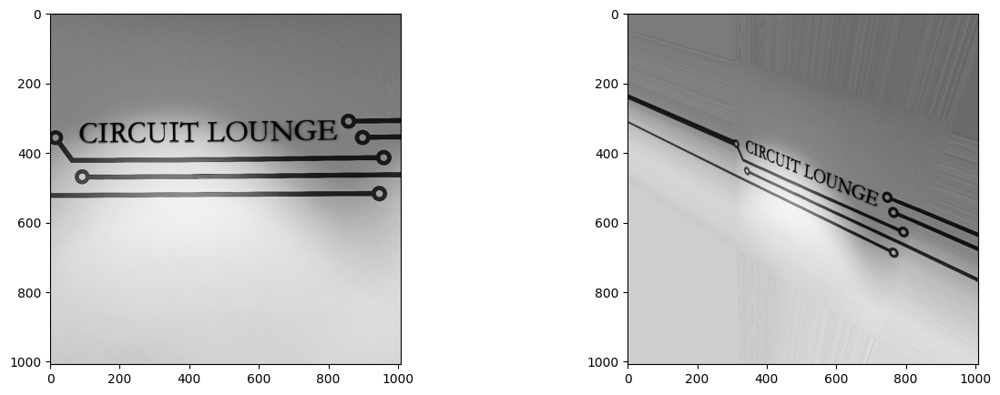

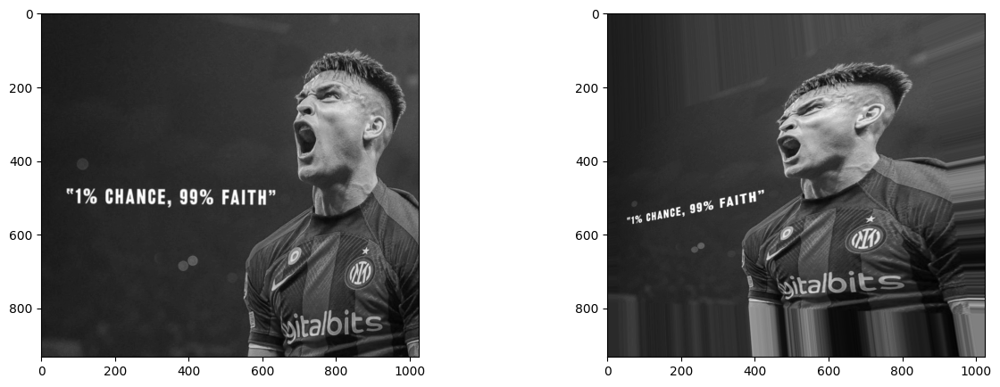

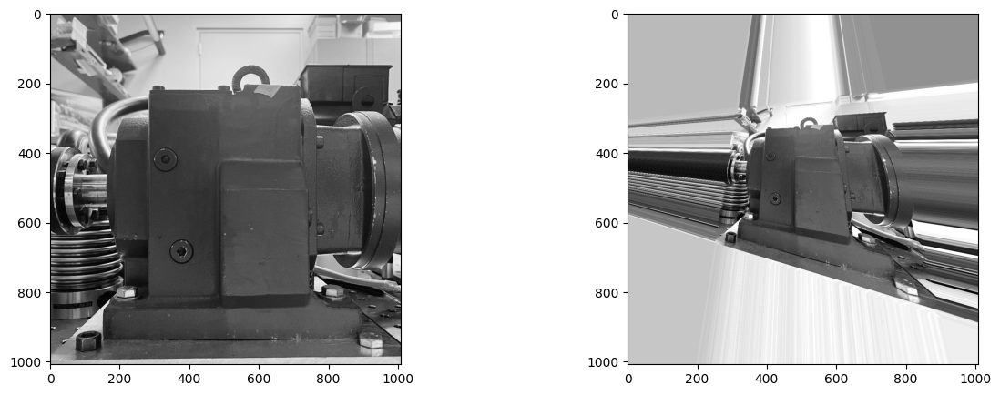

In [143]:
def scale_img (img):
    pass

def rotate_images(img, directory):
    
    image = cv.imread(directory + img, cv.IMREAD_GRAYSCALE)
    # image = image[499:1000, 499:1000]
    std_dev = 1
    if img == 'food_painting.jpg':
        k = 150
    else:
        k = 350
    pos_1 = np.random.randint(0, k, 2)
    pos_2 = np.random.randint(0, k, 2)
    pos_3 = np.random.randint(0, k, 2)
    pos_4 = np.random.randint(0, k, 2)
    angle = random.randint(-10, 10)

    # Initialize the rotation matrix
    rotation_matrix = cv.getRotationMatrix2D(center = (image.shape[1] / 2, image.shape[0] / 2), angle=angle, scale=1)
    # Add a third row for the rotation matrix so considering homogensous coordinates
    rotation_matrix = np.vstack([rotation_matrix, [0, 0, 1]])
    # Apply rotation to image
    rotated_image = cv.warpPerspective(image, rotation_matrix, (image.shape[1], image.shape[0]))
    # Define the image corners after rotation (Not really doing what it's supposed to do, change later if there is time)
    corner_1 = np.float32([0,0])
    corner_2 = np.float32([0, rotated_image.shape[1]-1])
    corner_3 = np.float32([rotated_image.shape[0]-1,rotated_image.shape[1]-1])
    corner_4 = np.float32([rotated_image.shape[0]-1, 0])

    # Define the source and destination points (Similar to Dr. McNames code)
    src_points = np.float32([corner_1, corner_2, corner_3, corner_4])
    dst_points = np.float32([corner_1 + pos_1, corner_2 + [pos_2[0], pos_2[1] - k], corner_3 + pos_3 - k, corner_4 + [pos_4[0] - k, pos_4[1]]])

    # Get the projective matrix
    projective_matrix = cv.getPerspectiveTransform(src_points, dst_points)
    warped_image = cv.warpPerspective(image, projective_matrix, (image.shape[1], image.shape[0]), borderMode=cv.BORDER_REPLICATE)

    brightness = np.random.randint(-50,50+1)
    cv.add(warped_image, brightness, warped_image)
    scale = 1 + np.random.uniform(-0.2,0.2)
    cv.multiply(warped_image, scale, warped_image)
    
    return image, warped_image, projective_matrix

dir = '../../sample_data/new/'
for img in os.listdir(dir):
    orig, rotated, matrix = rotate_images(img, directory=dir)
    fig, ax = plt.subplots(1, 2, figsize=(15, 5))
    ax[0].imshow(orig, cmap='gray')
    ax[1].imshow(rotated, cmap='gray')
# orig, rotated, matrix = rotate_images(img='lauti.JPG', directory=dir)
# fig, ax = plt.subplots(1, 2, figsize=(15, 5))
# ax[0].imshow(orig, cmap='gray')
# ax[1].imshow(rotated, cmap='gray')


**Apply the Harris corner detector to both images. Indicate the 20 most prominent features on the original image. Also indicate where you would expect the 20 most prominent features to occur in the transformed image. Finally, show the 20 most prominent features detected in the transformed image. Show 10 examples of randomly selected and transformed image pairs.**
---

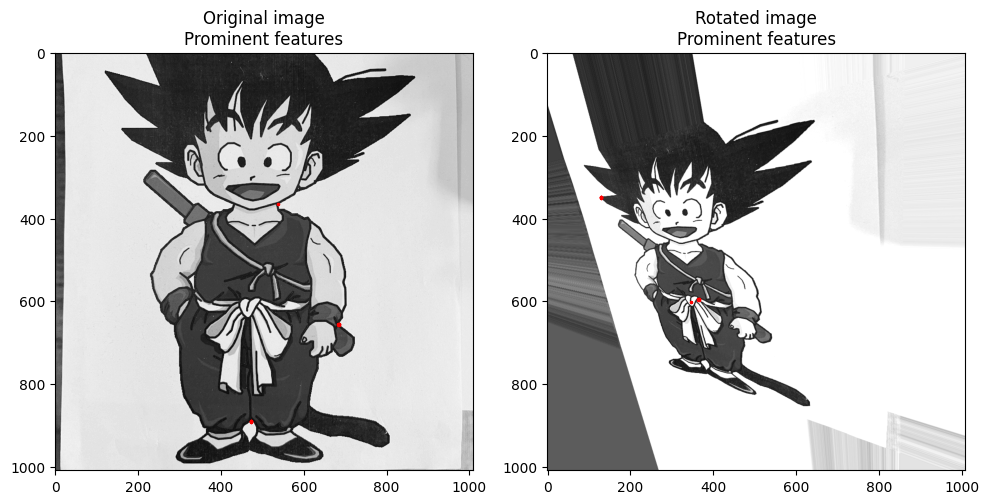

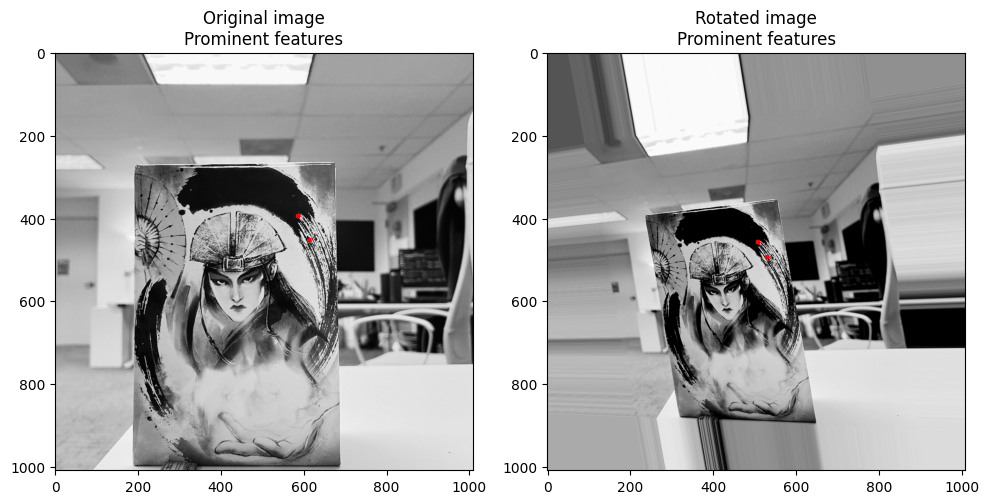

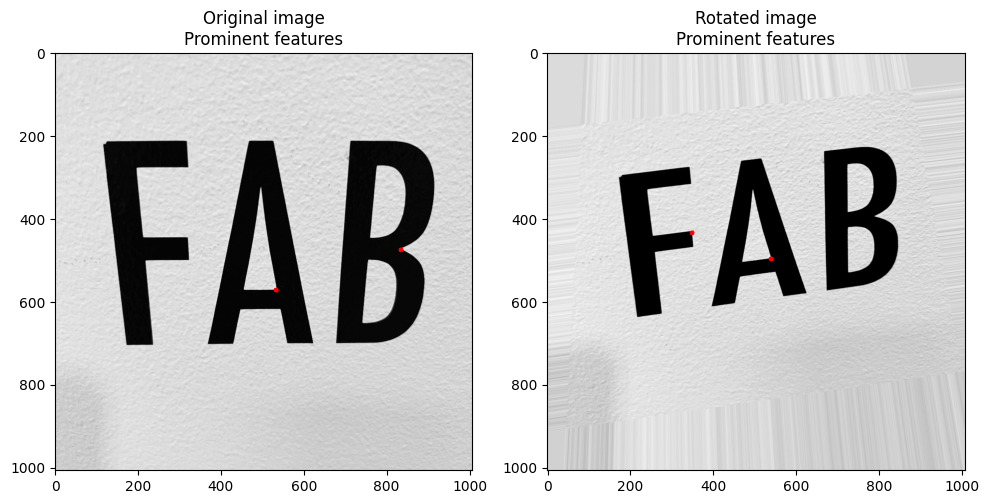

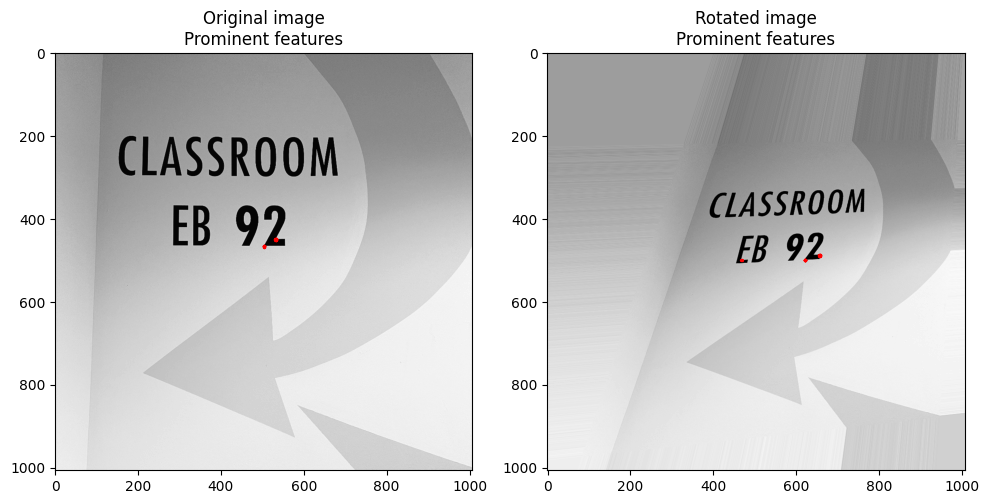

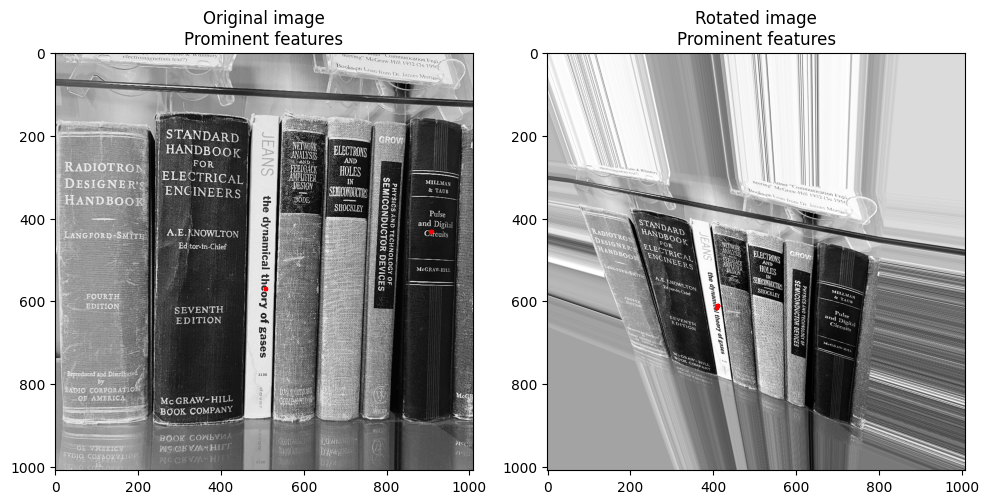

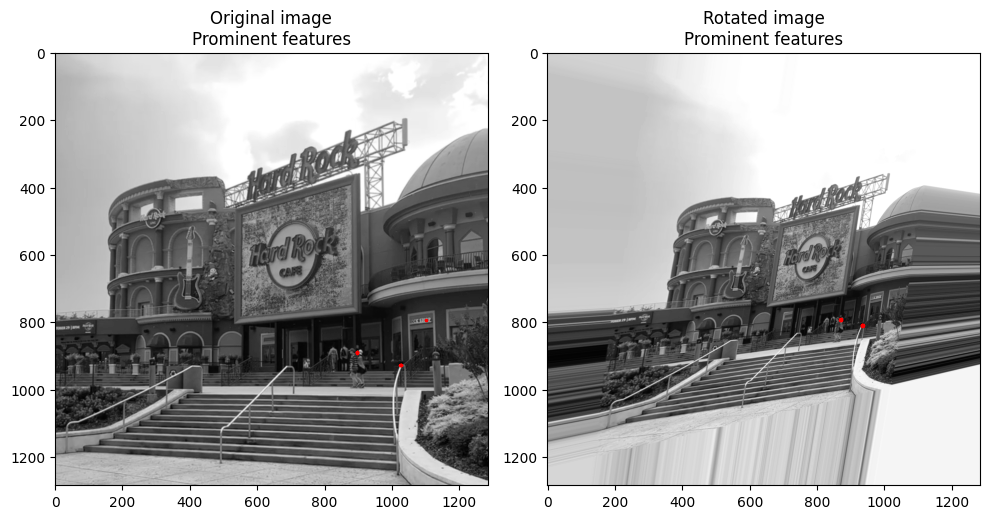

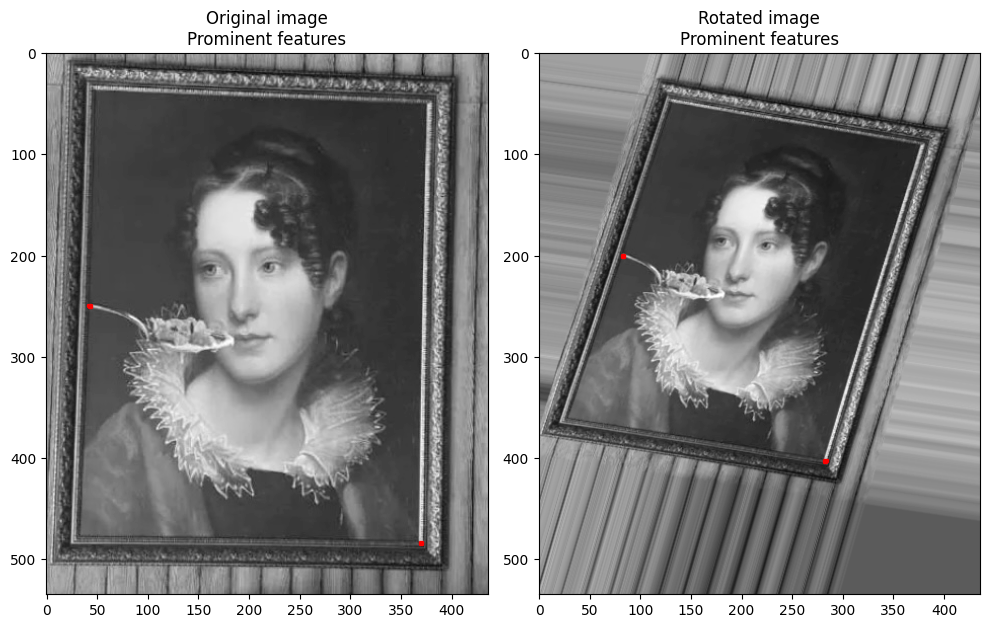

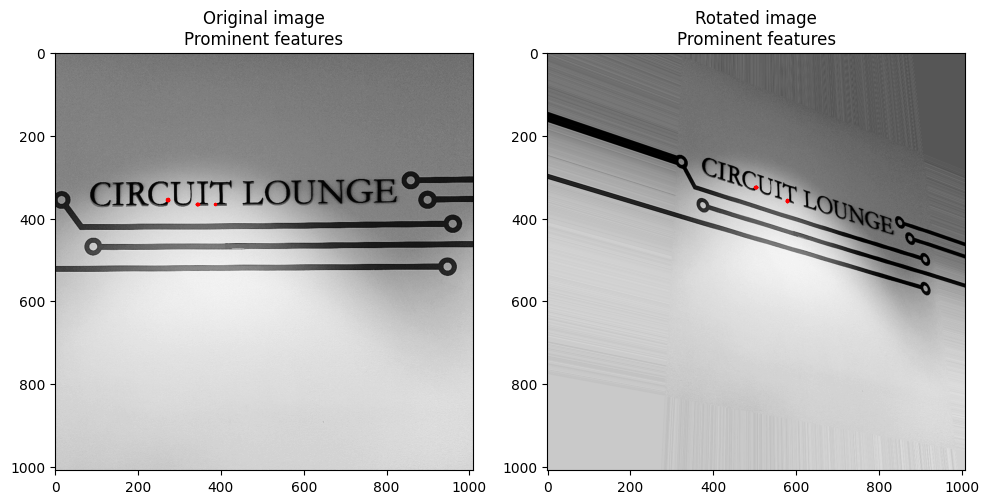

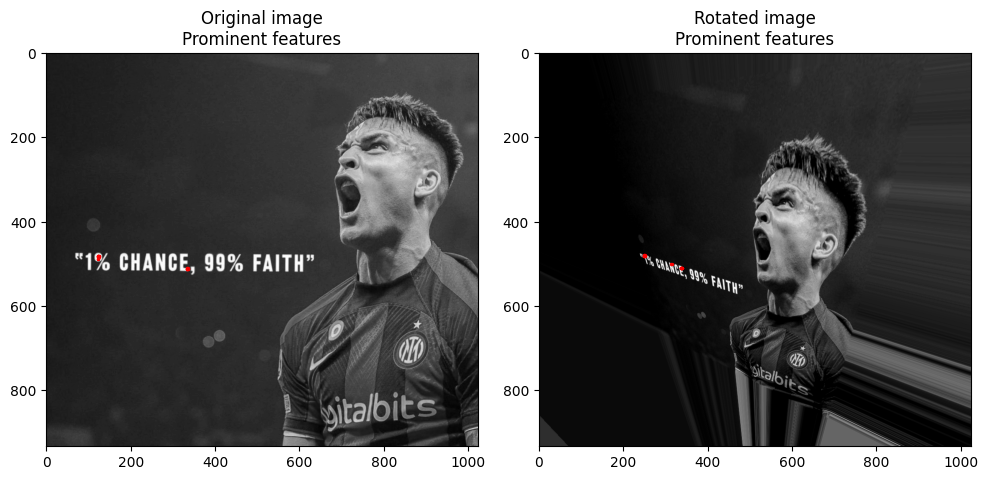

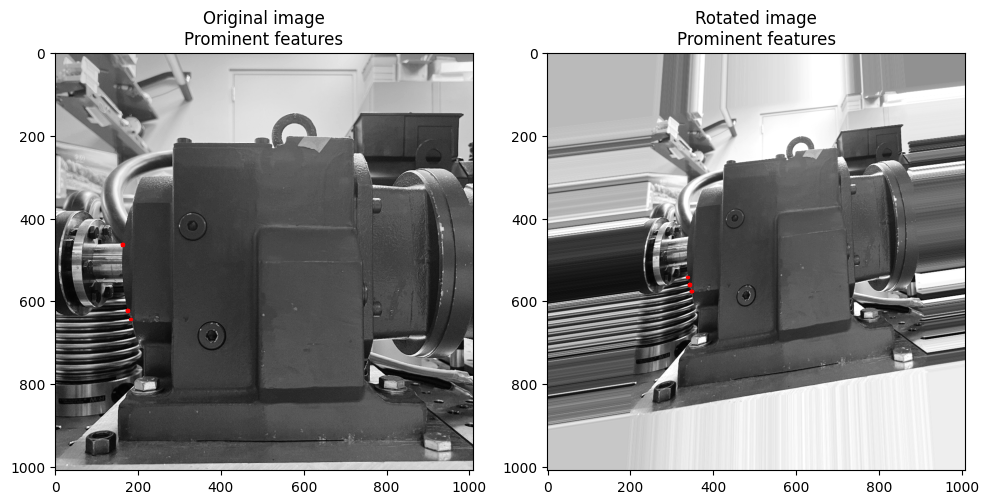

In [144]:
def harris_corner(img):
    # gray = cv.GaussianBlur(img, (7,7),0)
    # gray = np.float32(gray) # Why?
    gray = np.float32(img)
    dst = cv.cornerHarris(src=gray,blockSize=3,ksize=3,k=0.04) # Diff between ksize and blockSize?
    dst = cv.dilate(dst, None) # No kernel to the dilation = None.
    threshold = 0.01 * dst.max()
    mask = dst > threshold # Boolean. Values within the threshold are True, else False.
    coords = np.argwhere(mask) # 2D array. Return the indices of the none zero elements (NOT THE ELEMENTS THEMSELVES)
    return coords, dst

def get_prominent_features (coords, dst, features):
    detected_corners = []
    for corner in coords:
        y, x = corner # coordinates for each corner.
        corner_loc_image = dst[y,x] # Get the coords where the indices (x,y) point at in the image
        detected_corners.append(corner_loc_image) # Append the coordinates to a list so I can sort the prominent ones later.
    paired_corners = zip(coords, detected_corners)
    sorting = sorted(paired_corners, key=lambda x: x[1], reverse=True)
    no_resp_coords = sorting[:features]
    no_resp_coords = np.array([corner[0] for corner in no_resp_coords])
    return no_resp_coords


features = 20
for i, img_path in enumerate(images):
    fig, axs = plt.subplots(1, 2, figsize=(10, 10))
    orig, rotated, matrix = rotate_images(img_path, dir)
    coords1, dst1 = harris_corner(orig)
    coords2, dst2 = harris_corner(rotated)
    coords1 = get_prominent_features(coords1, dst1, features)
    coords2 = get_prominent_features(coords2, dst2, features)
    
    axs[0].imshow(orig, cmap='gray')
    axs[0].scatter(coords1[:,1], coords1[:,0], c='r', marker='o', s=2)
    axs[0].set_title('Original image\nProminent features')
    
    axs[1].imshow(rotated, cmap='gray')
    axs[1].scatter(coords2[:,1], coords2[:,0], c='r', marker='o', s=2)
    axs[1].set_title('Rotated image\nProminent features')

    plt.tight_layout()

# plt.show()

In this attemp to solve this question, I sorted the features in a descending order to get the prominent ones first. This step, by the way, did not make a difference. The features detected in the original image are overlapping. The harris response (R) from the matrix calculations are very close to each other for each feature, if not the same. Despite this, the features on the transformed images are similar to the ones in the original image. 

Out of curiosity, I increased the number of features to see corners detected in each image.

**Harris corner with the first 100 prominent features:**

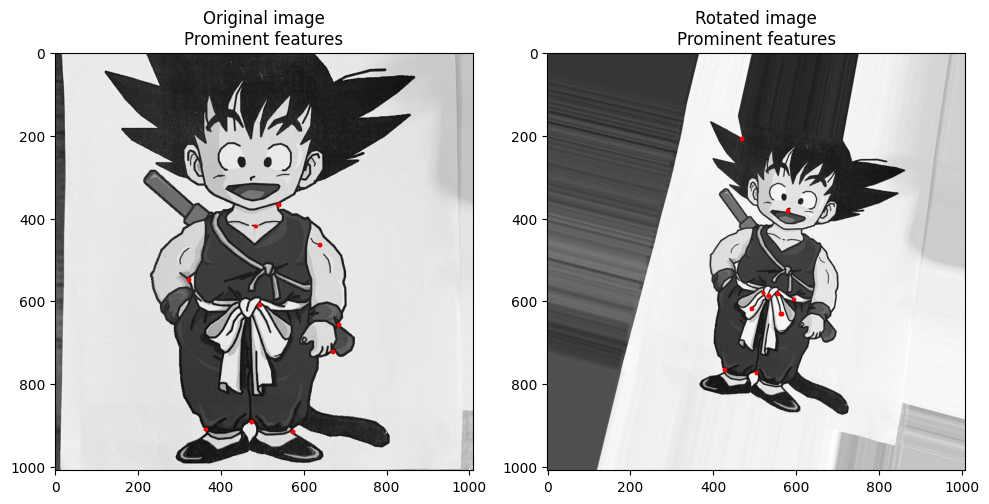

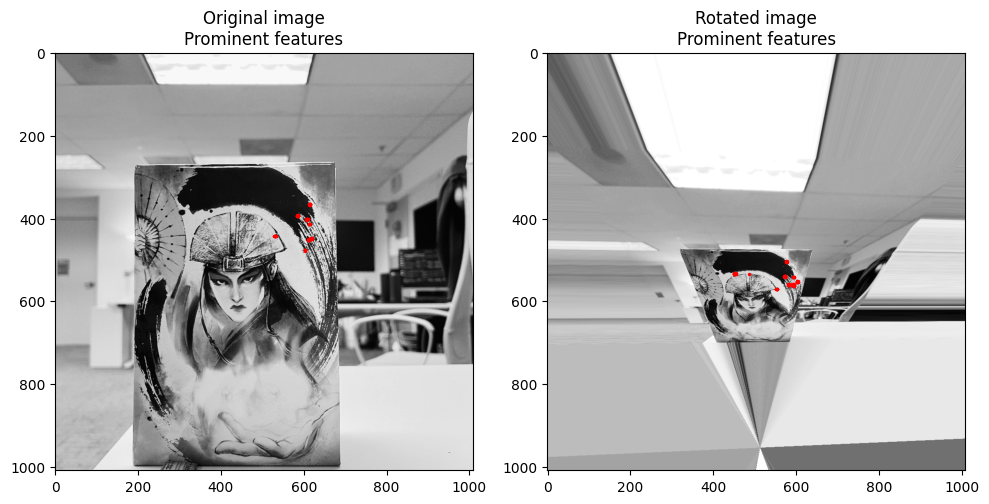

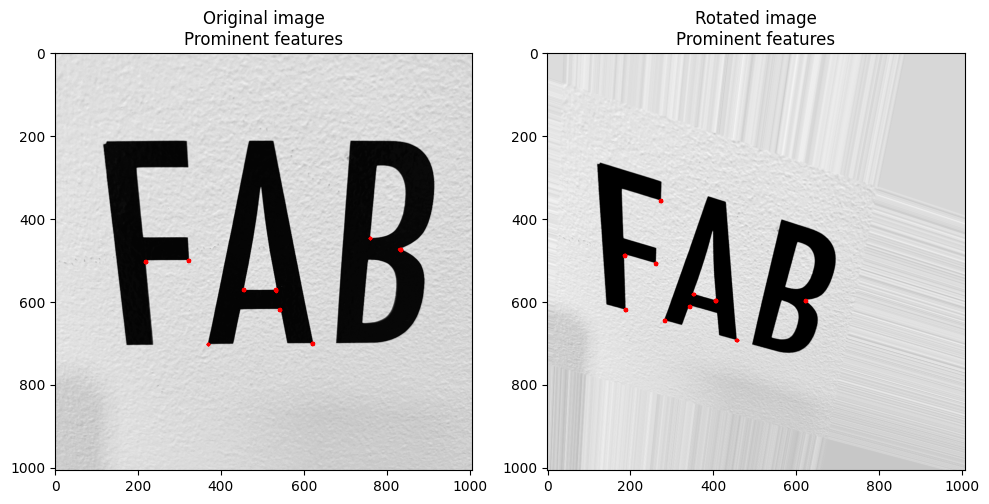

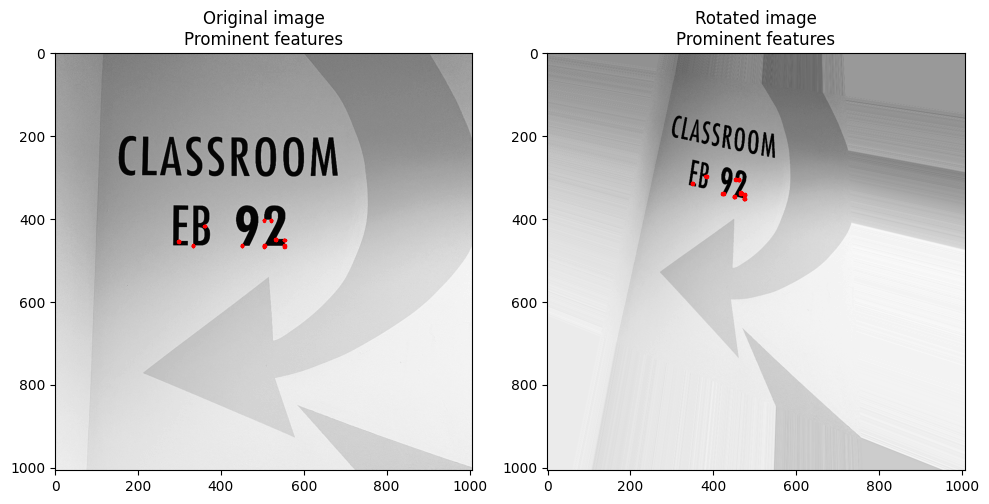

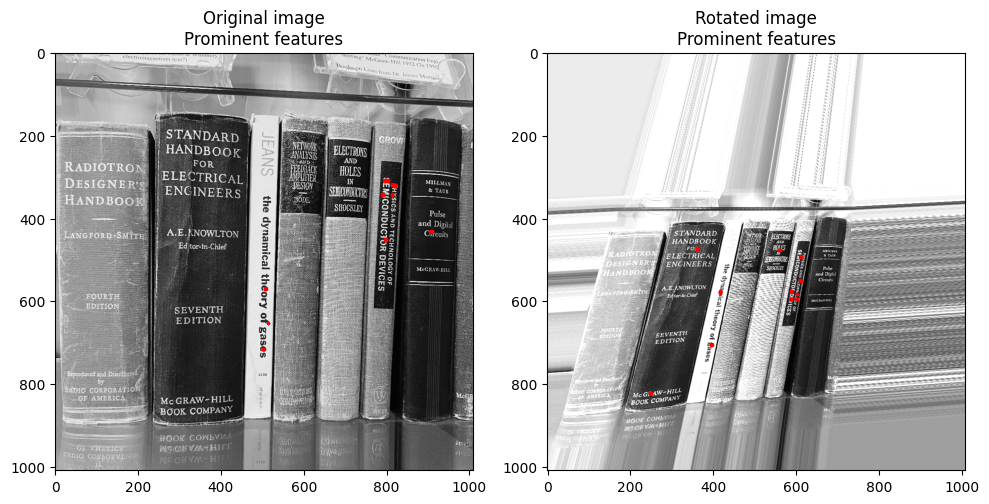

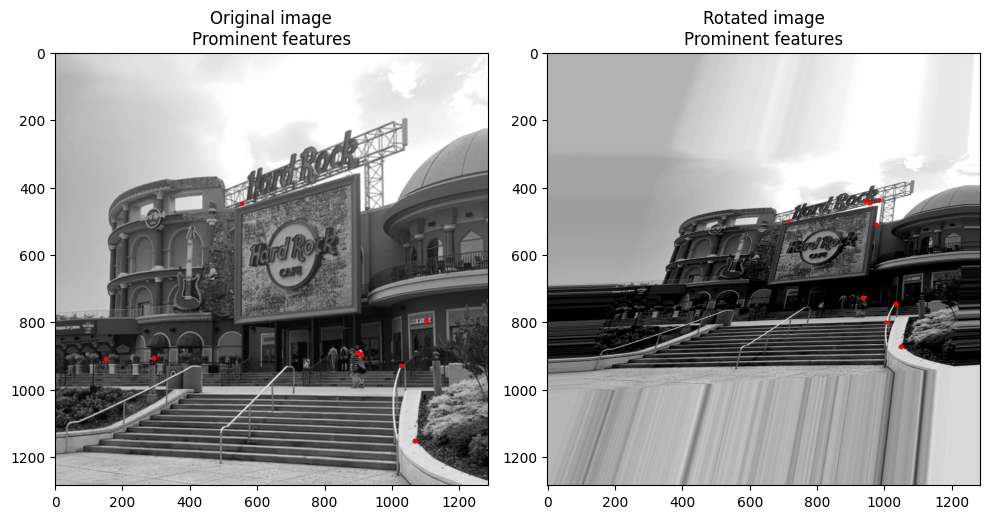

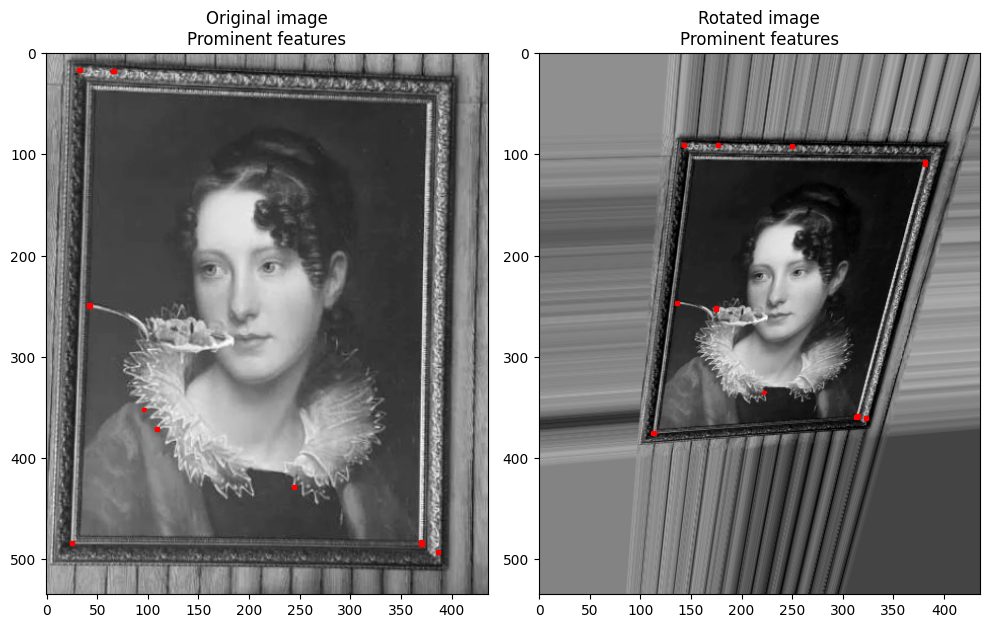

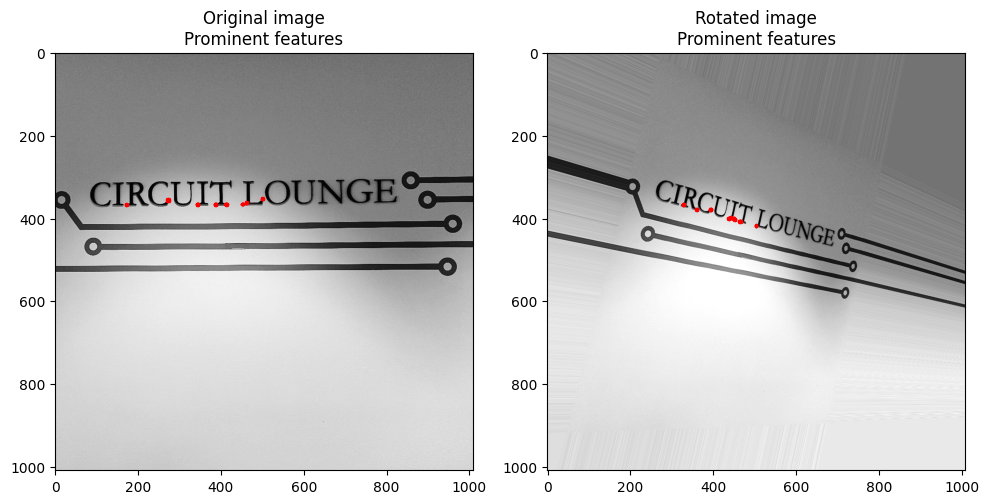

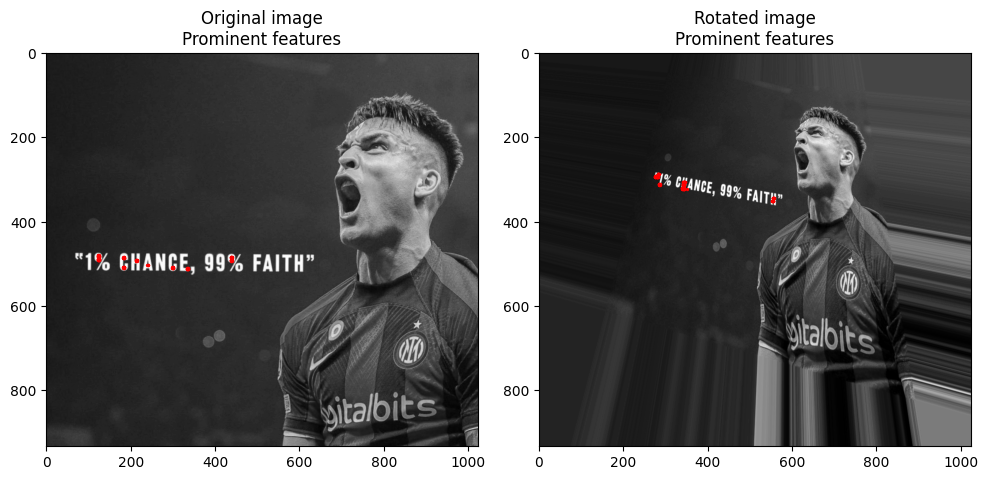

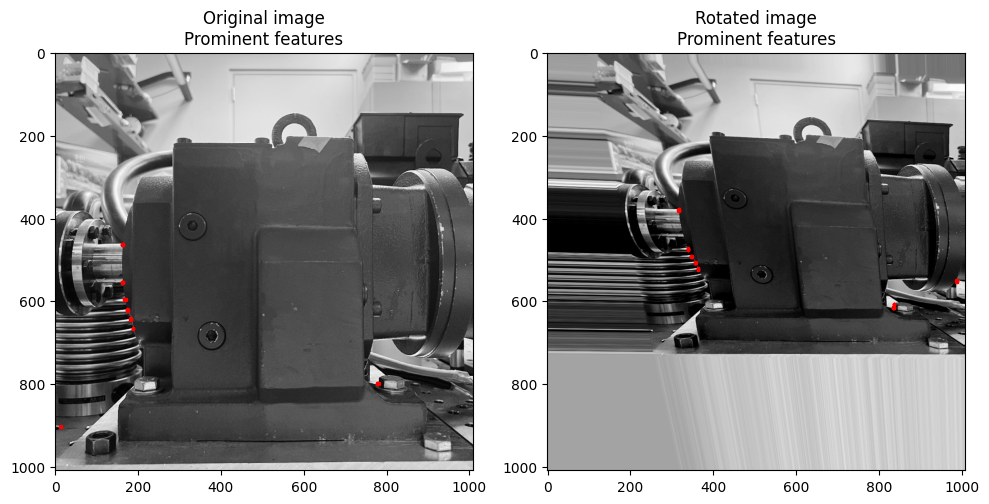

In [145]:
features = 100
for i, img_path in enumerate(images):
    fig, axs = plt.subplots(1, 2, figsize=(10, 10))
    orig, rotated, matrix = rotate_images(img_path, dir)
    coords1, dst1 = harris_corner(orig)
    coords2, dst2 = harris_corner(rotated)
    coords1 = get_prominent_features(coords1, dst1, features)
    coords2 = get_prominent_features(coords2, dst2, features)
    
    axs[0].imshow(orig, cmap='gray')
    axs[0].scatter(coords1[:,1], coords1[:,0], c='r', marker='o', s=2)
    axs[0].set_title('Original image\nProminent features')
    
    axs[1].imshow(rotated, cmap='gray')
    axs[1].scatter(coords2[:,1], coords2[:,0], c='r', marker='o', s=2)
    axs[1].set_title('Rotated image\nProminent features')

    plt.tight_layout()

Note that in the last image, the "circuit lounge", the corners are mostly detected in the portion where the light intensity is high. The corners of the letters at the end of the word "lounge" are not detected. I think this is because of the light intensity of the image.

**For each image pair, calculate the number of matches. A match occurs when a point is detected in both images within 1 pixel. Repeat this many times to get a precise estimate of the percentage of matches.**
---

In [146]:
features = 20
threshold = 1
accuracy_images = {}
for im in images:
    orig, rotat, matrix = rotate_images(im, dir)
    coords1, harris_img1 = harris_corner(orig)
    coords2, harris_img2 = harris_corner(rotat)
    coords1 = get_prominent_features(coords1, harris_img1, features)
    coords2 = get_prominent_features(coords2, harris_img2, features)
    matches = matching_corners(orig_coords=coords1, rotated_coords=coords2)
    acc = get_accuracy(matches, threshold=threshold)
    accuracy_images[i] = {'acc': acc}
    sorted_images = {k: v for k, v in sorted(accuracy_images.items(), key=lambda x: x[1]['acc'], reverse=True)}
    print(f'\nIteration {i}:')
    print(f'image name:{im.split(".")[0]}')
    for k in sorted_images.keys():
        print(f'accuracy: {sorted_images[k]["acc"]}')
    


Iteration 9:
image name:_modified_character
accuracy: 0.0

Iteration 9:
image name:_modified_book
accuracy: 0.0

Iteration 9:
image name:_modified_fab
accuracy: 0.0

Iteration 9:
image name:_modified_classroom
accuracy: 0.0

Iteration 9:
image name:_modified_books
accuracy: 0.0

Iteration 9:
image name:hardrock
accuracy: 0.0

Iteration 9:
image name:food_painting
accuracy: 0.0

Iteration 9:
image name:_modified_ckt_lounge
accuracy: 0.0

Iteration 9:
image name:lauti
accuracy: 0.0

Iteration 9:
image name:_modified_gearbox
accuracy: 0.0


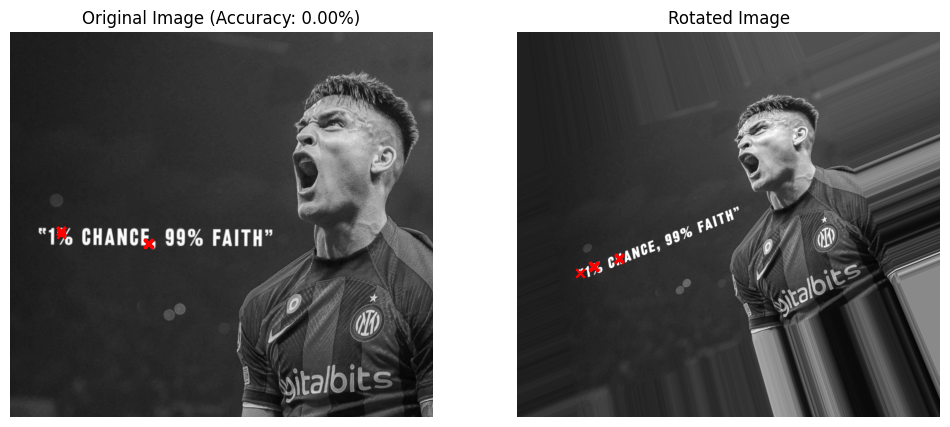

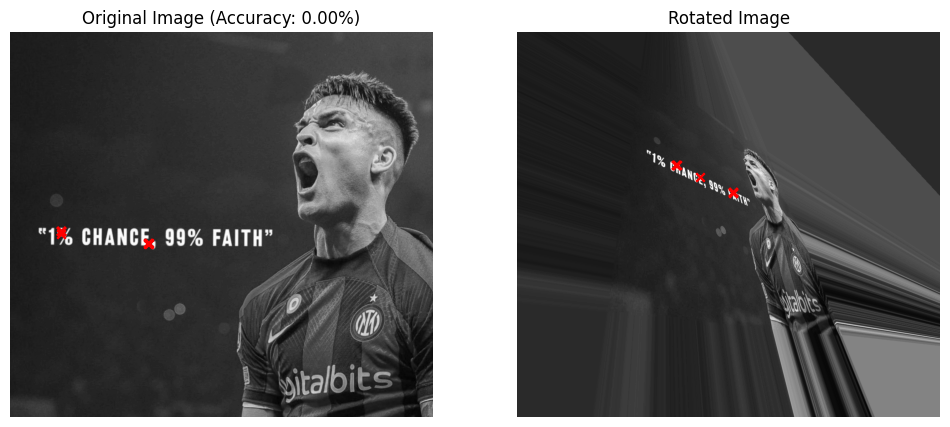

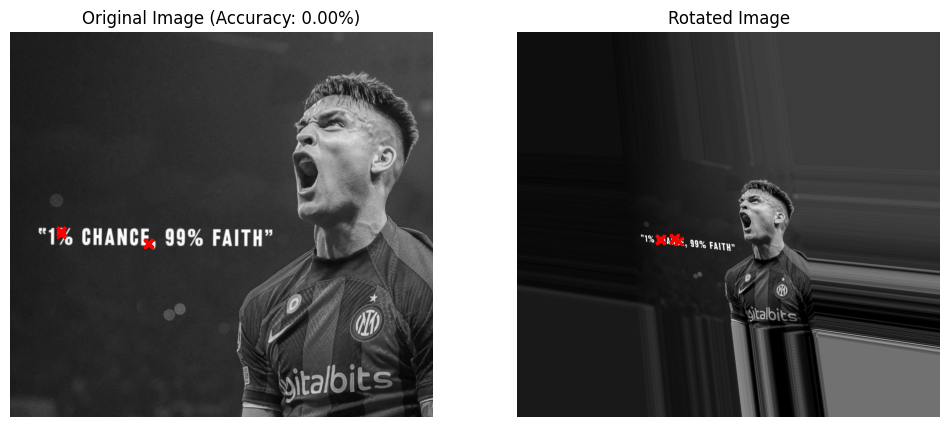

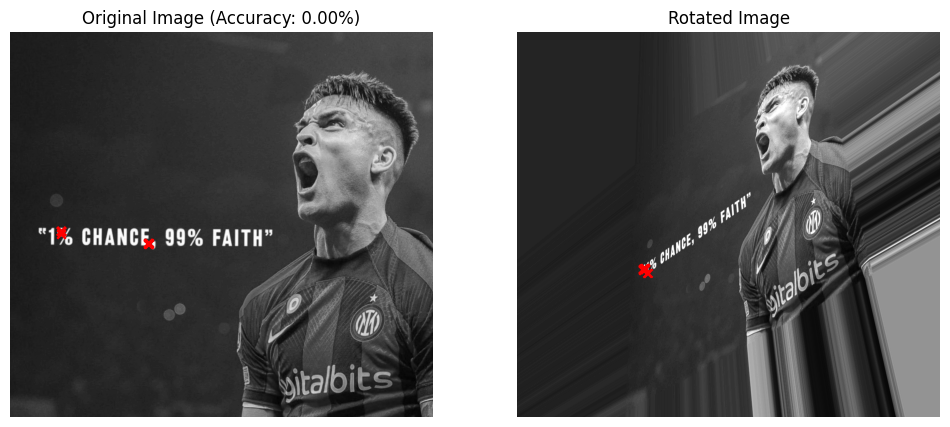

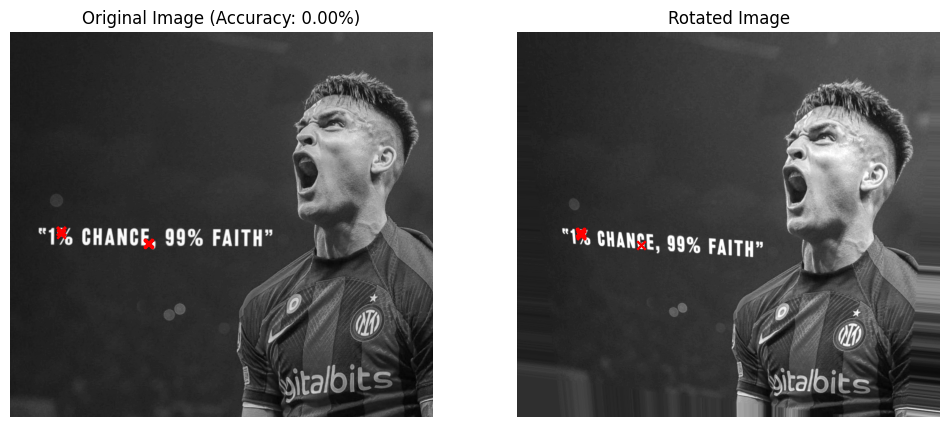

In [148]:
def img_iterations(img, dir, features, threshold):
    accuracy_images = {}
    for i in range(1000):
        orig, rotat, matrix = rotate_images(img, dir)
        coords1, harris_img1 = harris_corner(orig)
        coords2, harris_img2 = harris_corner(rotat)
        coords1 = get_prominent_features(coords1, harris_img1, features)
        coords2 = get_prominent_features(coords2, harris_img2, features)
        matches = matching_corners(orig_coords=coords1, rotated_coords=coords2)
        acc = get_accuracy(matches, threshold=threshold)
        accuracy_images[i] = {'acc': acc, 'orig': orig, 'rotat': rotat, 'coords1': coords1, 'coords2': coords2}

    sorted_images = {k: v for k, v in sorted(accuracy_images.items(), key=lambda x: x[1]['acc'], reverse=True)}

    for i in range(5):
        data = list(sorted_images.values())[i]
        acc = data['acc']
        orig = data['orig']
        rotat = data['rotat']
        coords1 = data['coords1']
        coords2 = data['coords2']

        fig, ax = plt.subplots(1, 2, figsize=(12, 6))
        ax[0].imshow(orig, cmap='gray')
        ax[0].scatter(coords1[:, 1], coords1[:, 0], c='r', marker='x')
        ax[0].set_title(f'Original Image (Accuracy: {acc*100:.2f}%)')
        ax[0].axis('off')
        
        ax[1].imshow(rotat, cmap='gray')
        ax[1].scatter(coords2[:, 1], coords2[:, 0], c='r', marker='x')
        ax[1].set_title('Rotated Image')
        ax[1].axis('off')
        
dir = '../../sample_data/new/'
features = 20
threshold = 1
img_iterations('lauti.JPG', dir, features, threshold)

I calculated the accuracy using the euclidean distance between each pair of two points. For a 1000 iterations, the heighest accuracy value was 84%. I may lose this due to running the cell multiple times. In the case where the accuracy was 84%, the transformed image looked like the original image with the x and y axis transformed with 12% off of the original image. 

Increasing the neighboring pixels to more than 1 is expected to give a better accuracy. Again, out of curiosity, I'll try this next:

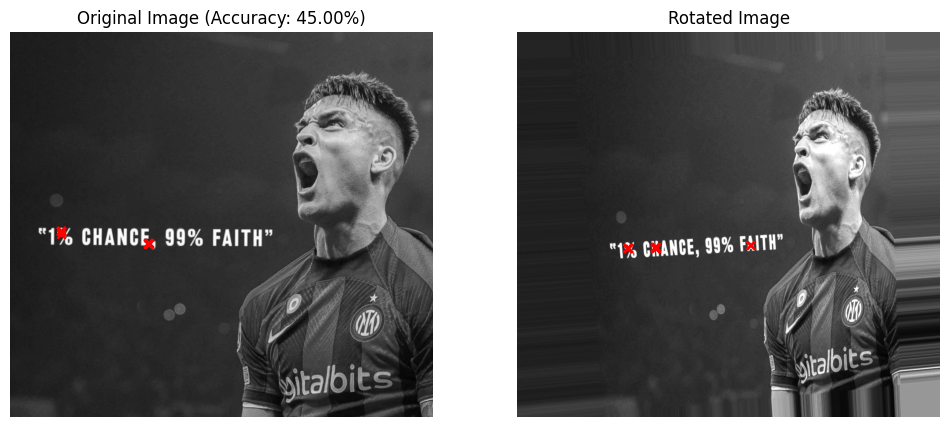

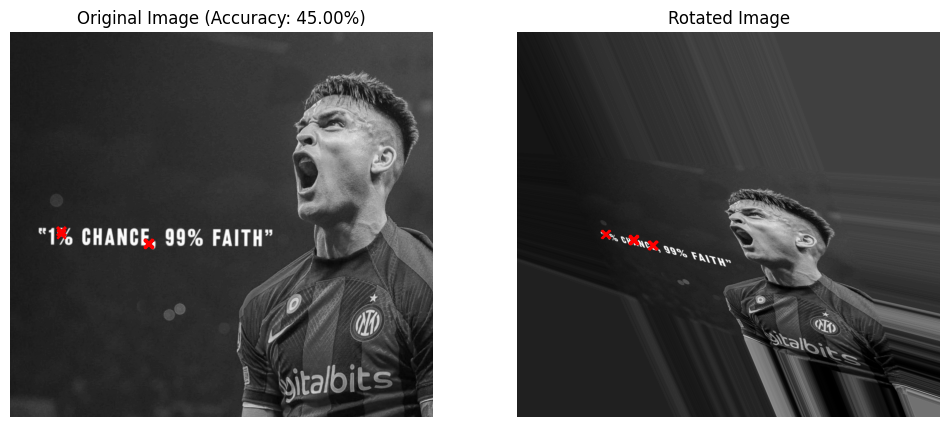

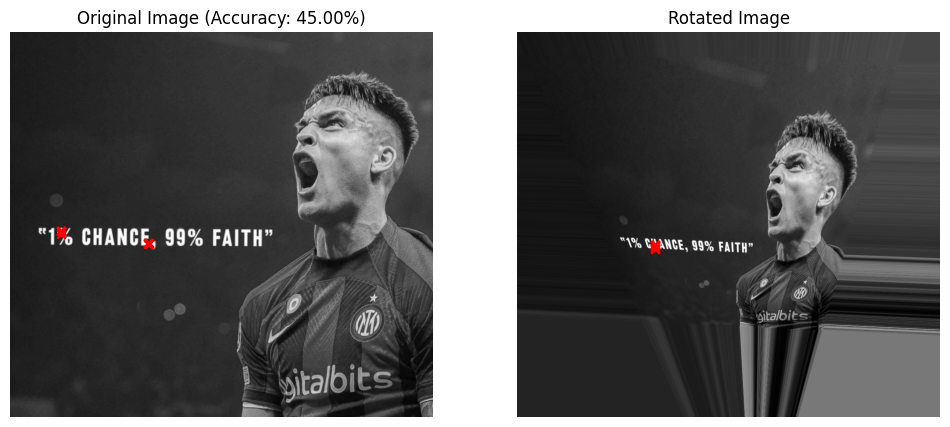

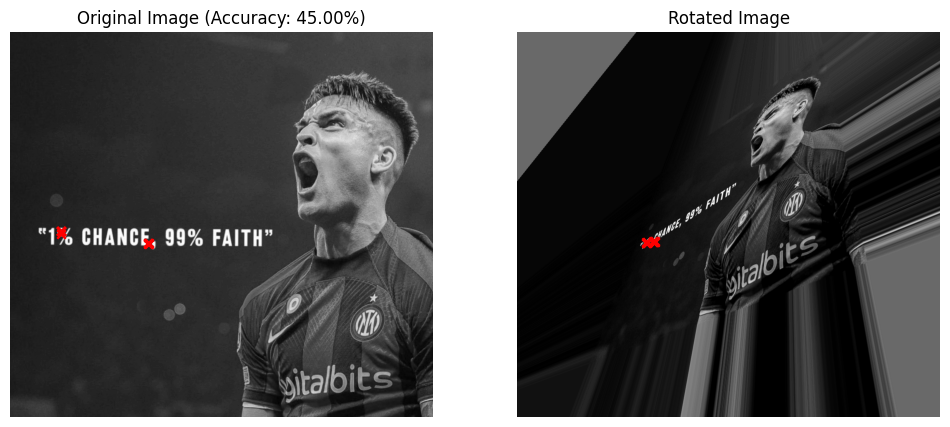

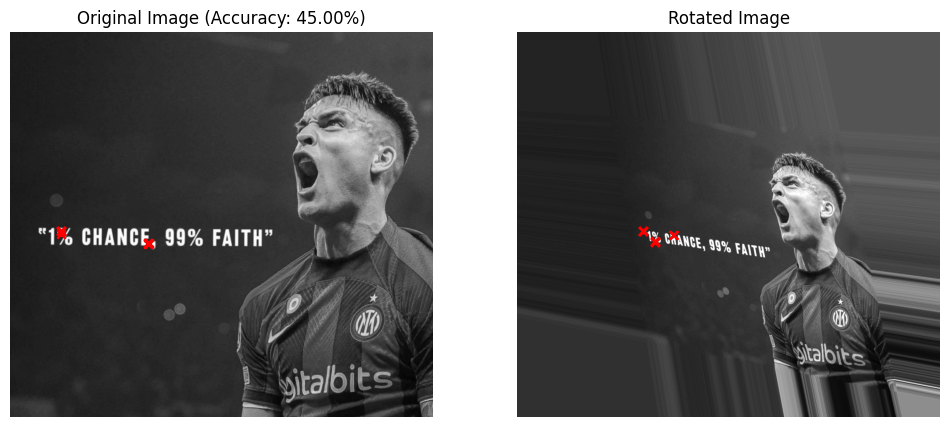

In [149]:
features = 20
threshold = 10
img_iterations('lauti.JPG', dir, features, threshold)

As the number of neighboring pixels increases, the accuracy average increases as well.

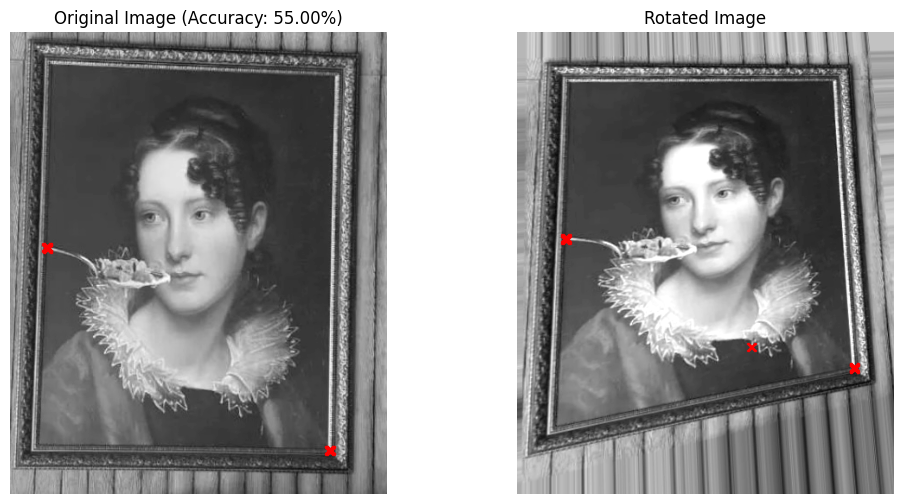

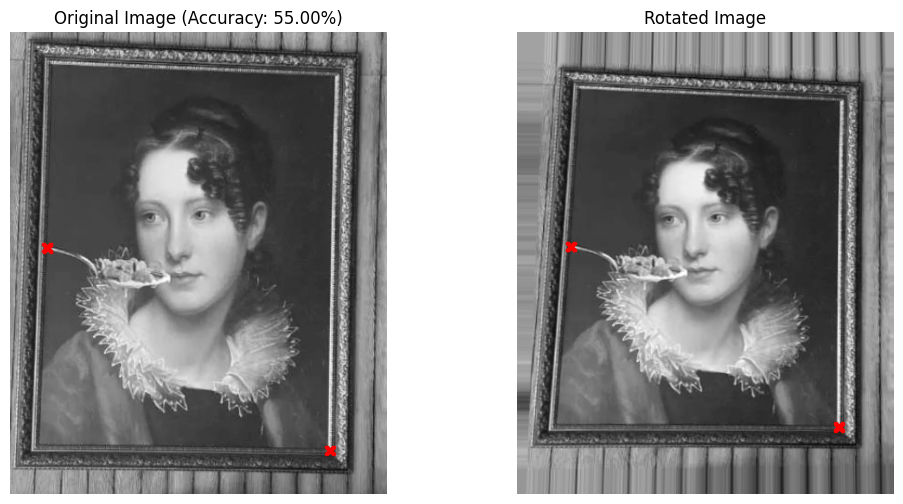

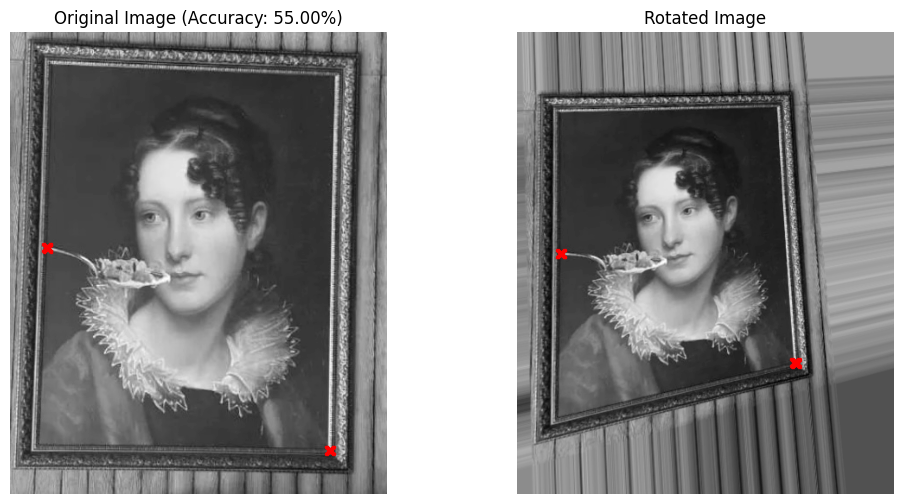

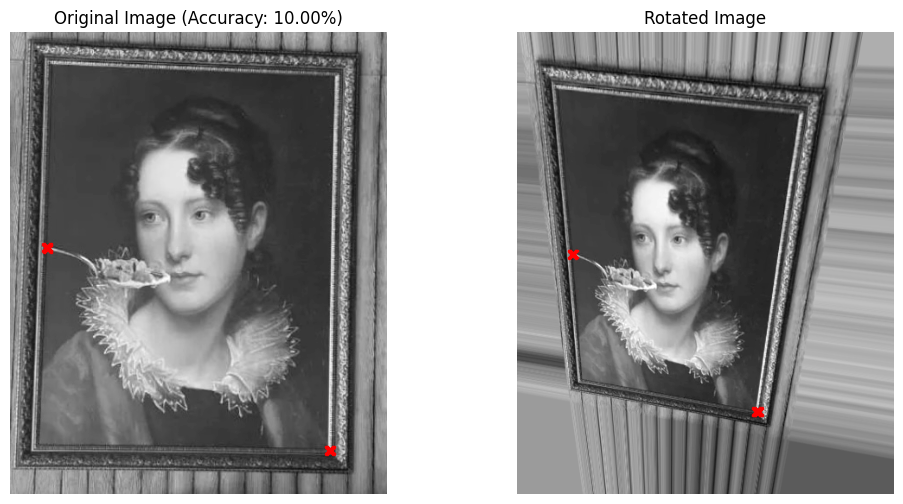

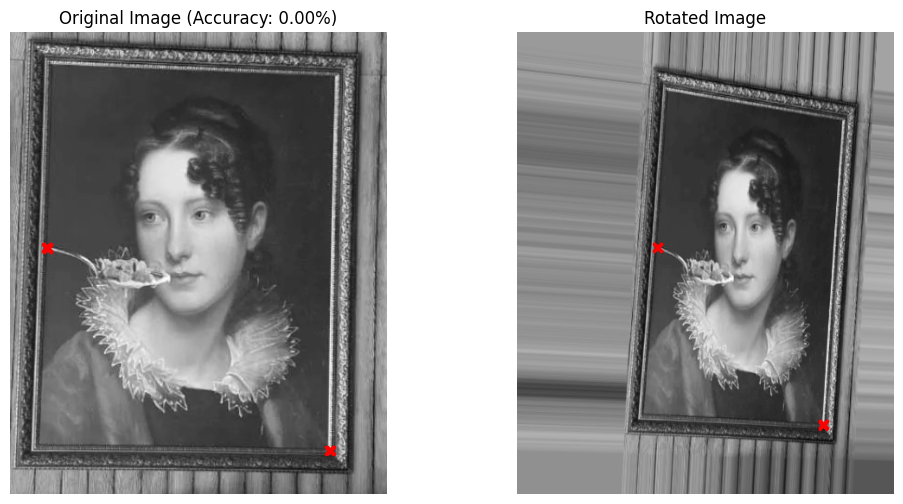

In [178]:
features = 20
threshold = 20
img_iterations('food_painting.jpg', dir, features, threshold)

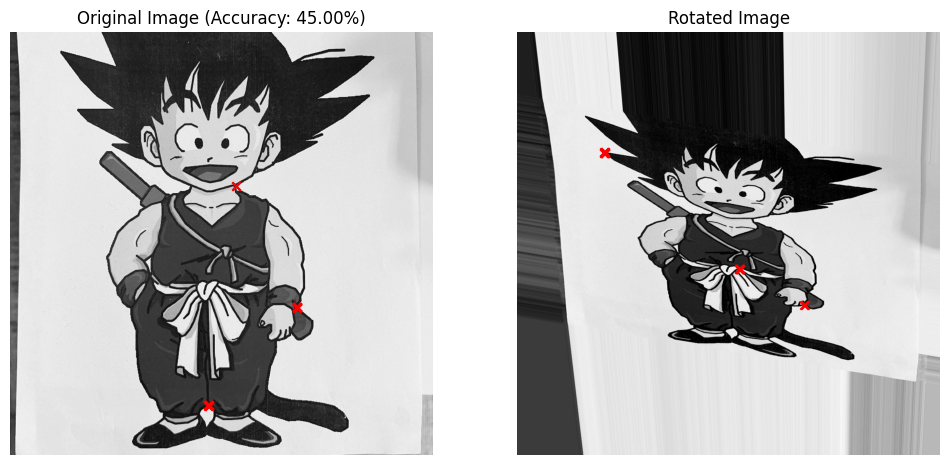

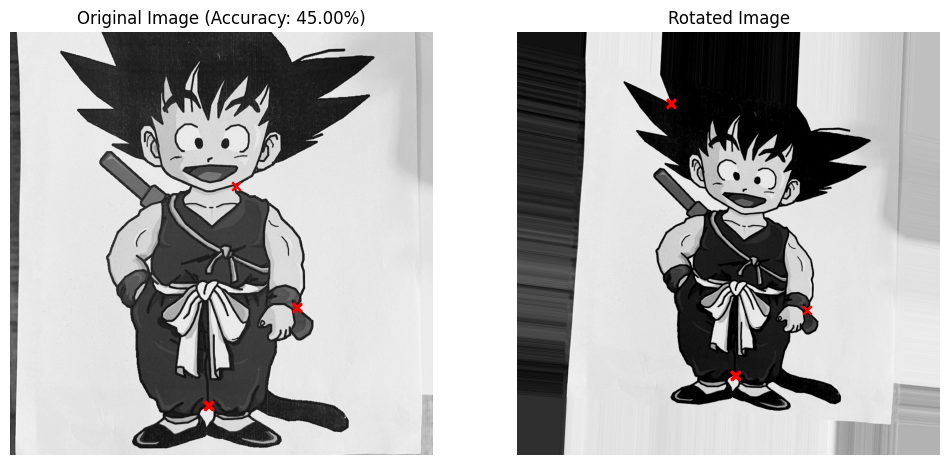

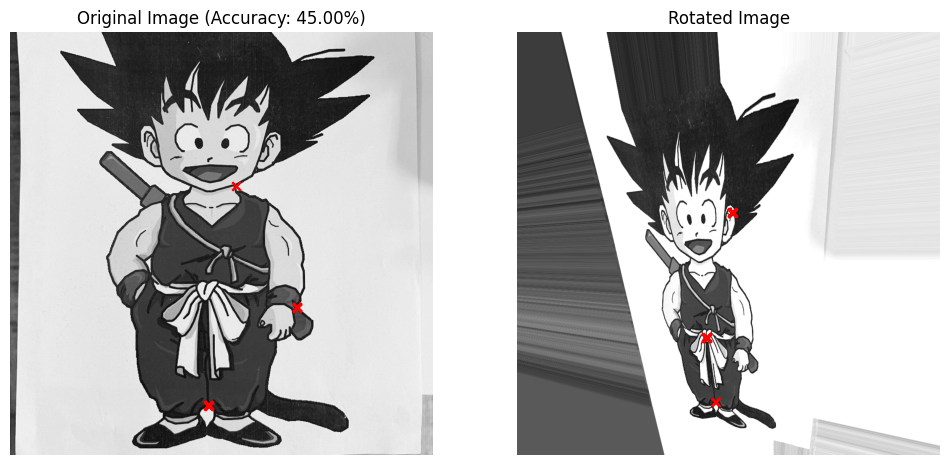

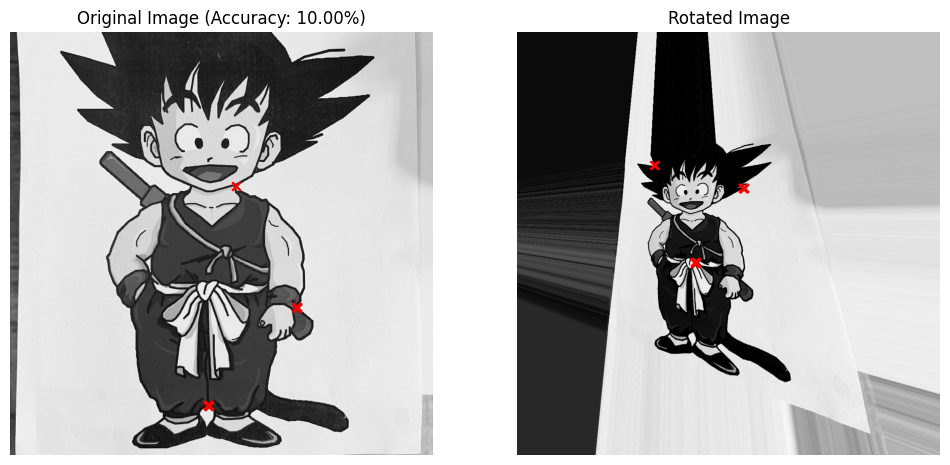

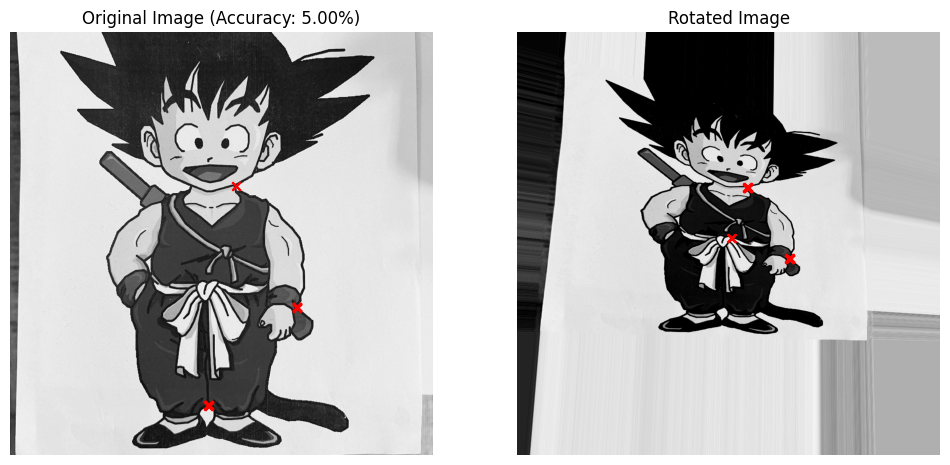

In [179]:
features = 20
threshold = 10
img_iterations('_modified_character.jpg', dir, features, threshold)

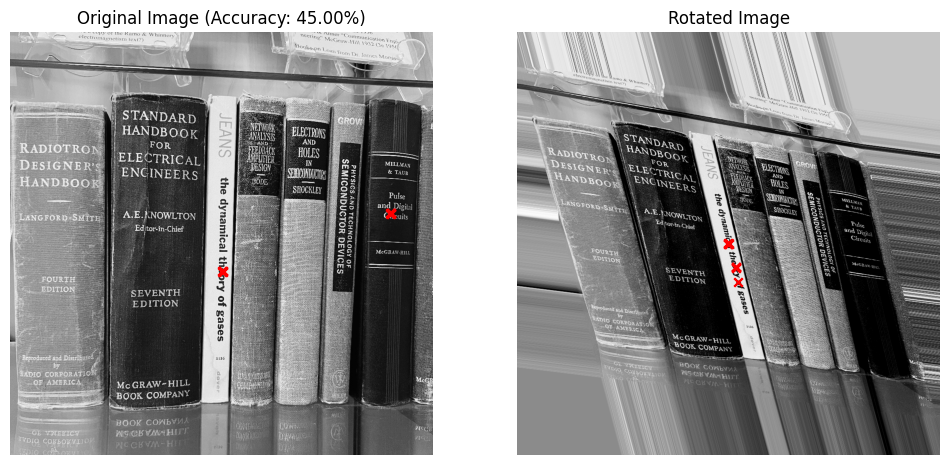

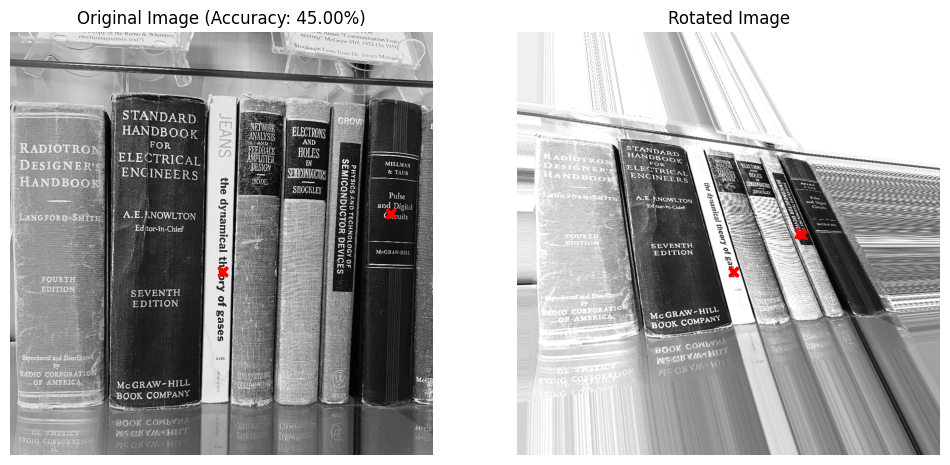

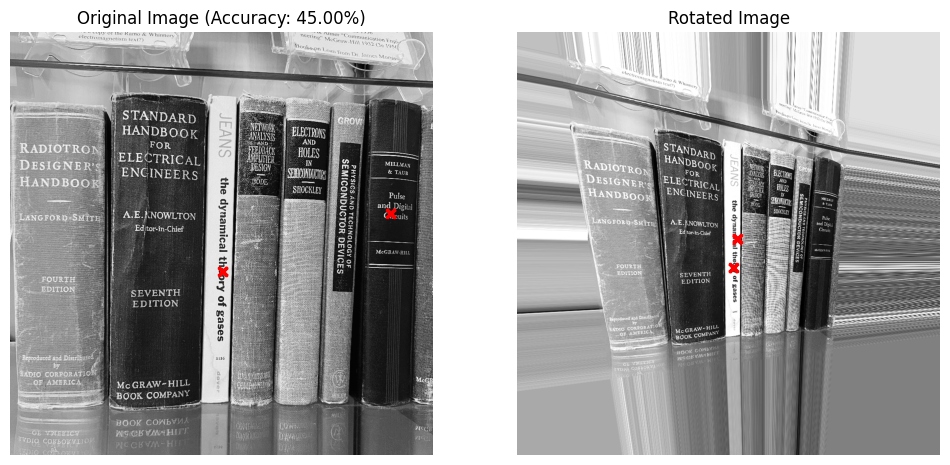

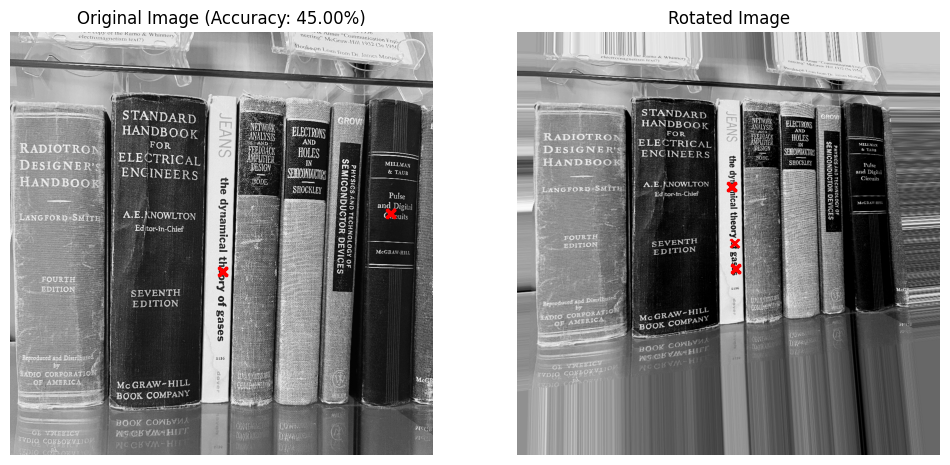

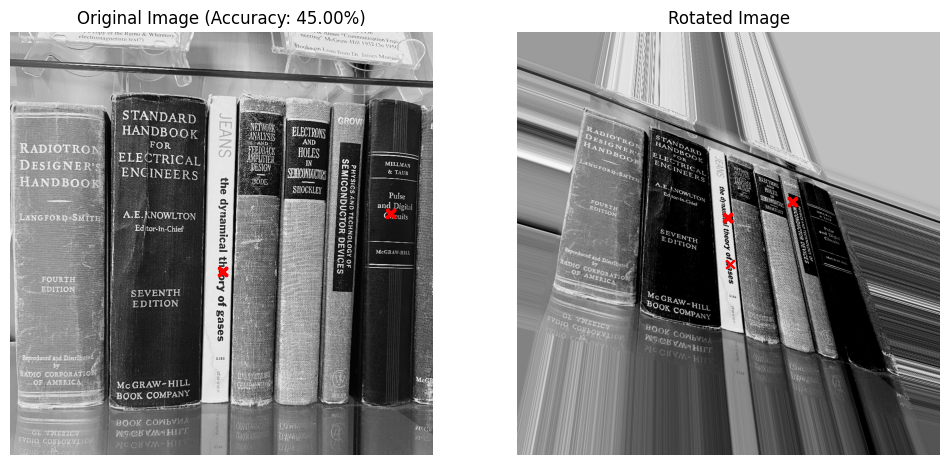

In [180]:
features = 20
threshold = 20
img_iterations('_modified_books.jpg', dir, features, threshold)

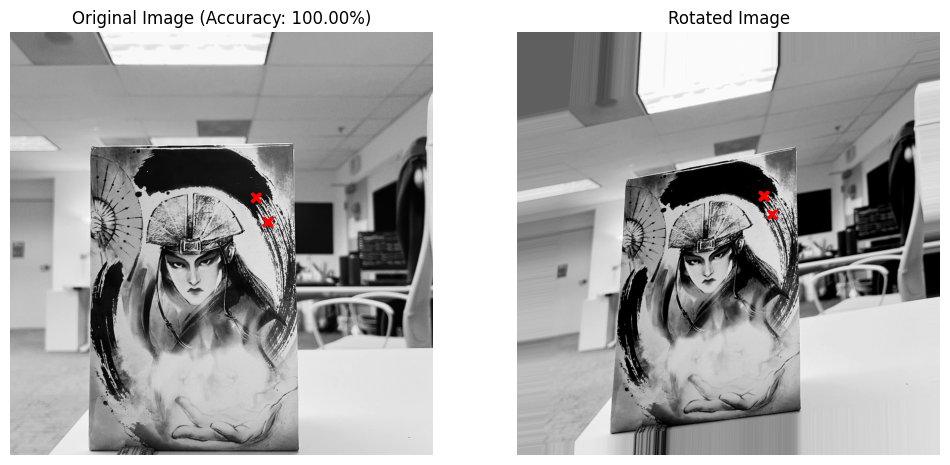

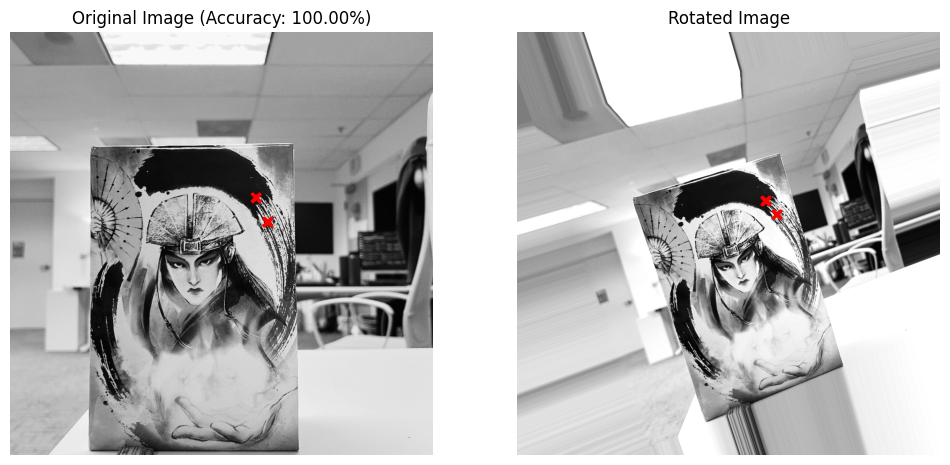

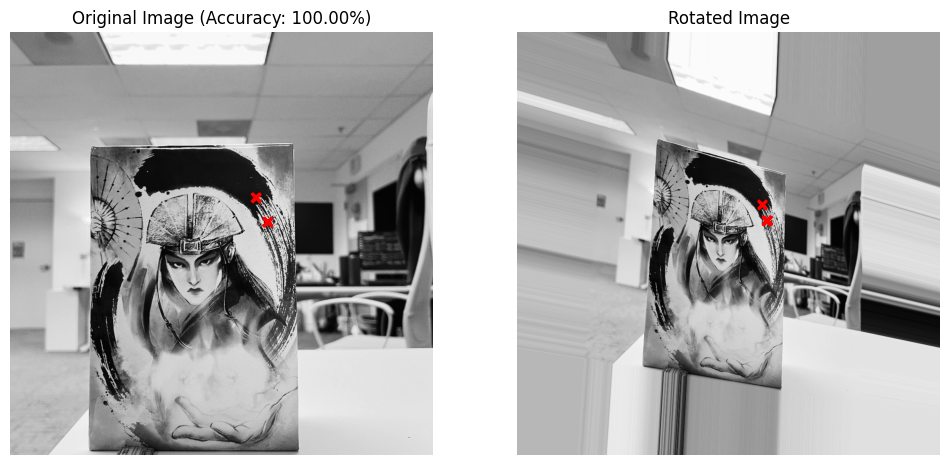

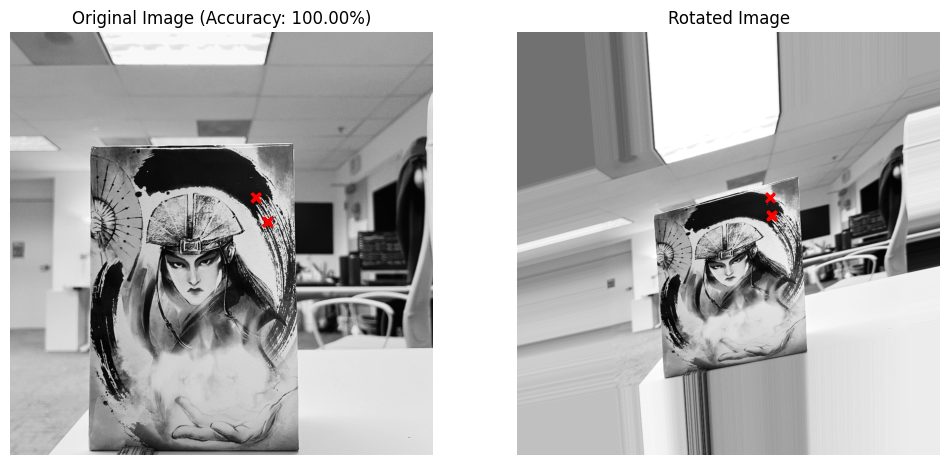

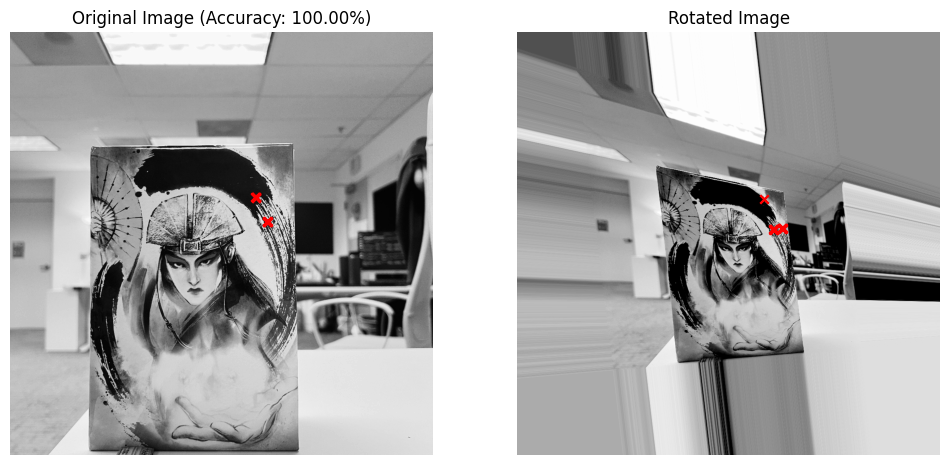

In [181]:
features = 20
threshold = 20
img_iterations('_modified_book.jpg', dir, features, threshold)

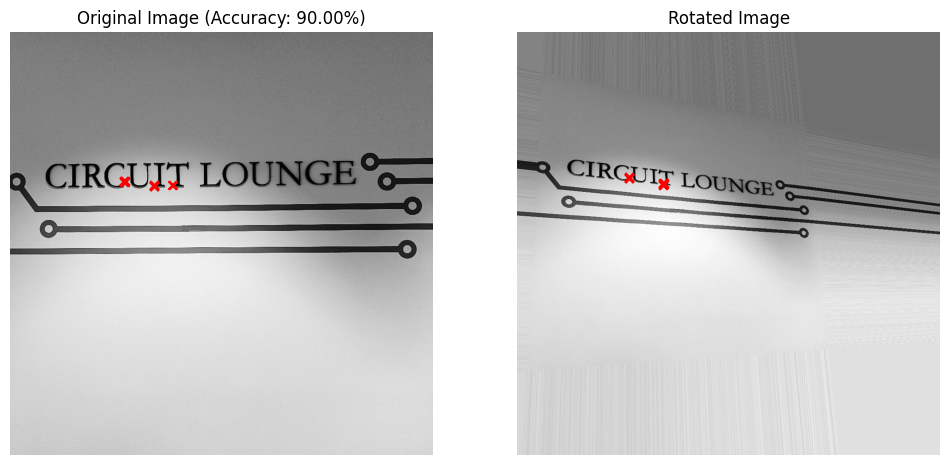

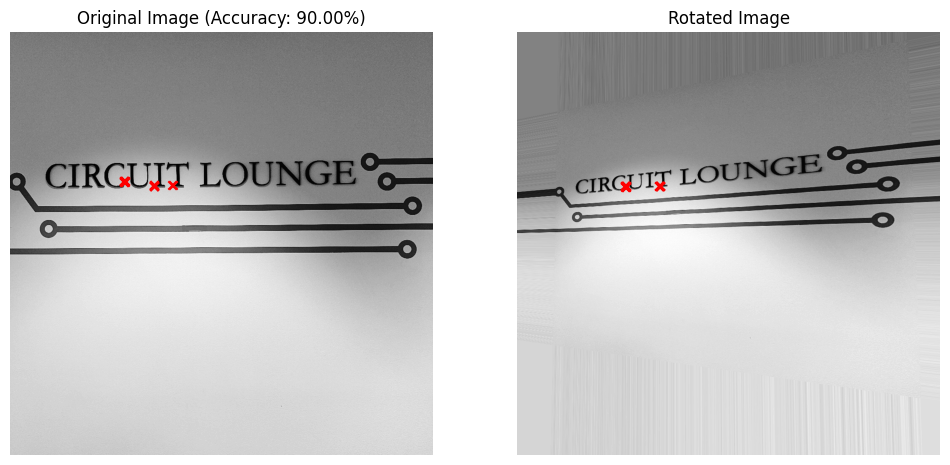

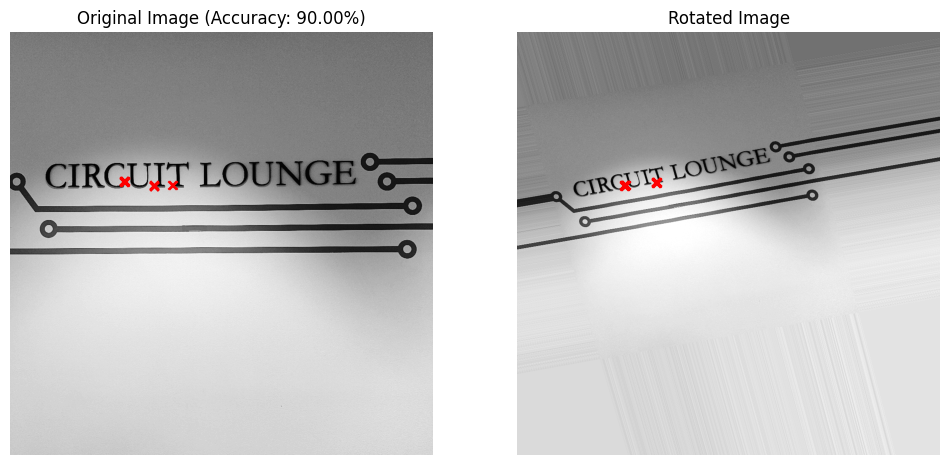

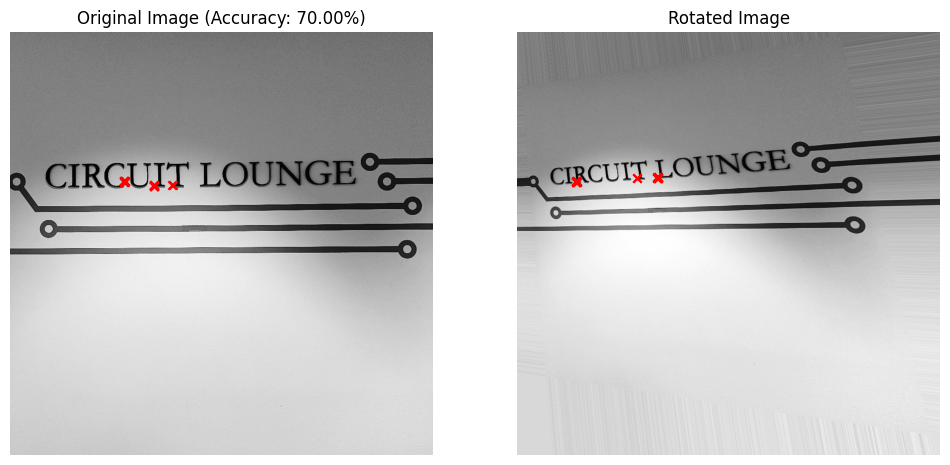

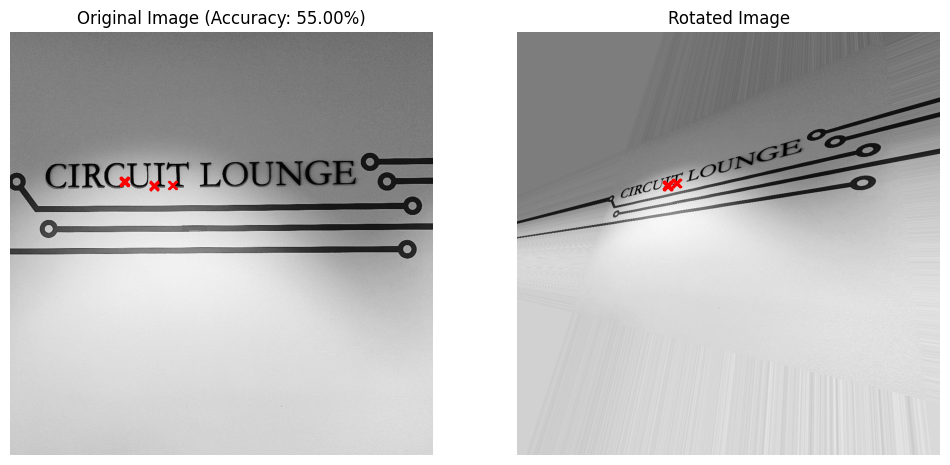

In [182]:
features = 20
threshold = 20
img_iterations('_modified_ckt_lounge.jpg', dir, features, threshold)

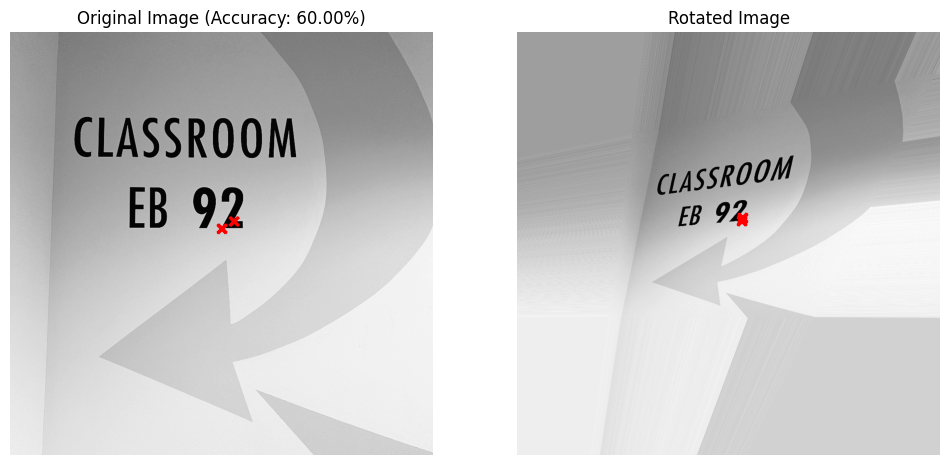

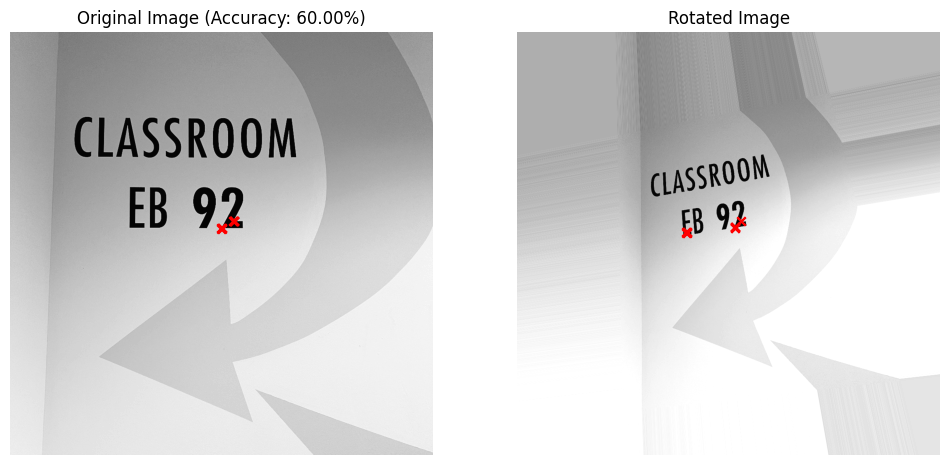

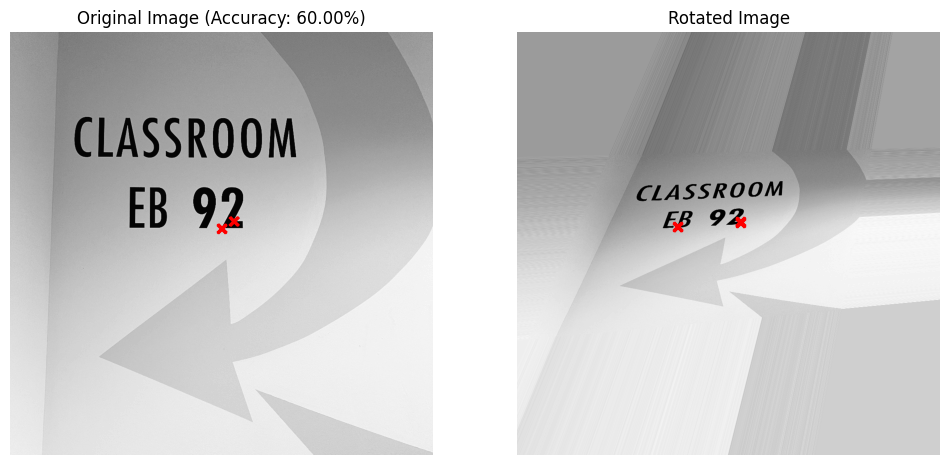

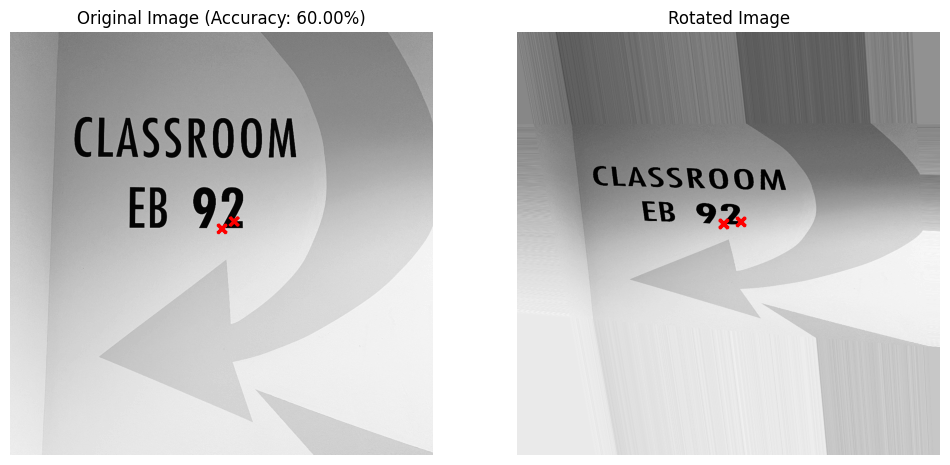

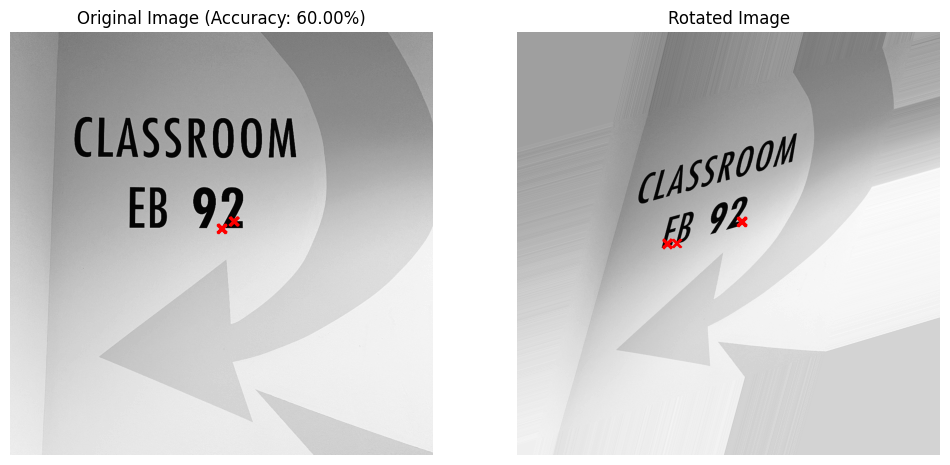

In [184]:
features = 20
threshold = 5
img_iterations('_modified_classroom.jpg', dir, features, threshold)

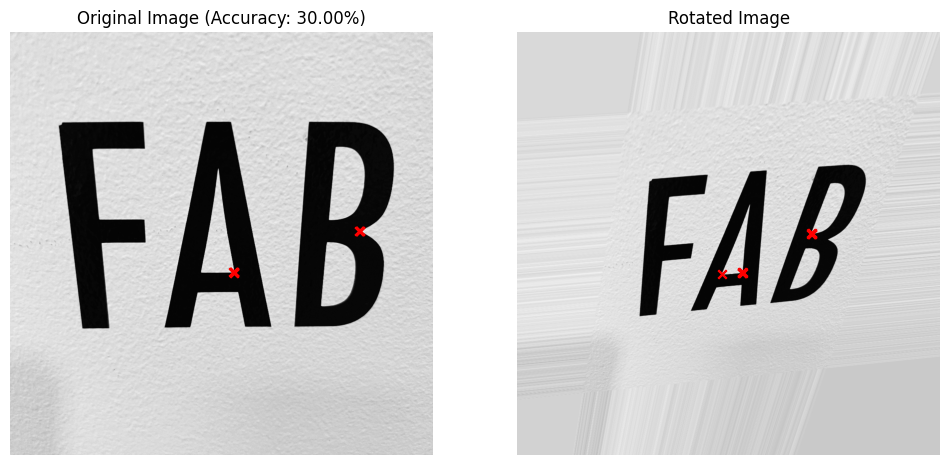

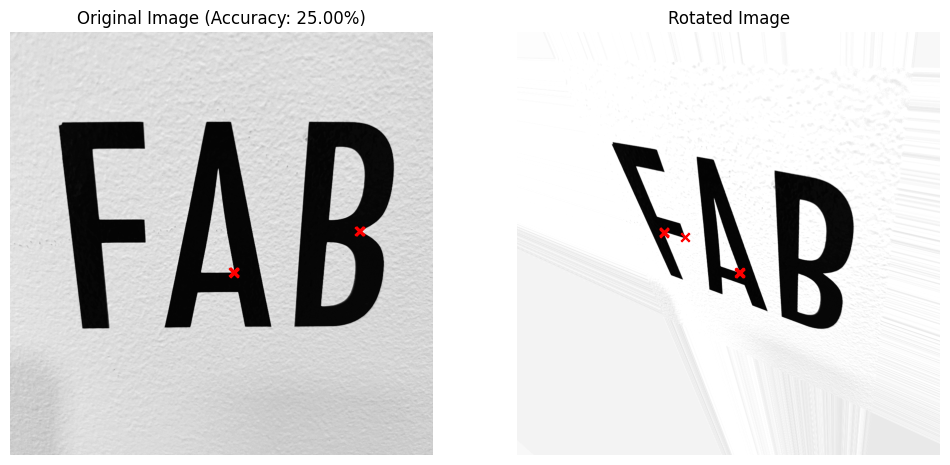

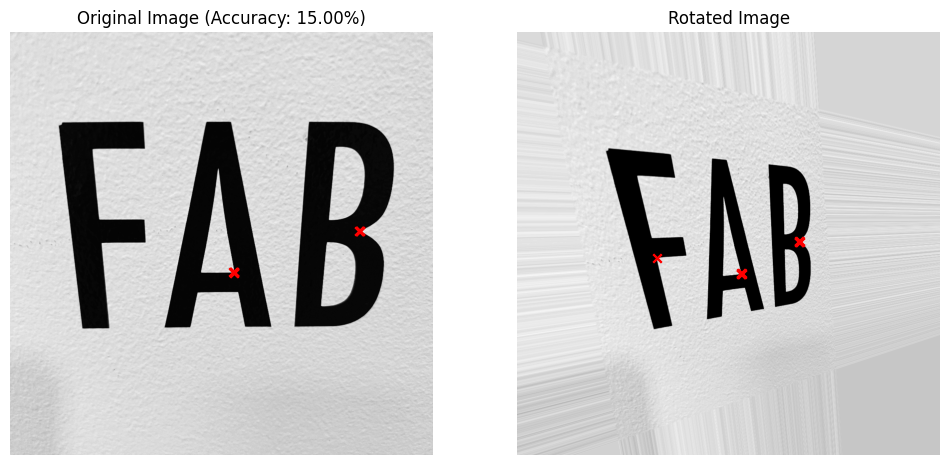

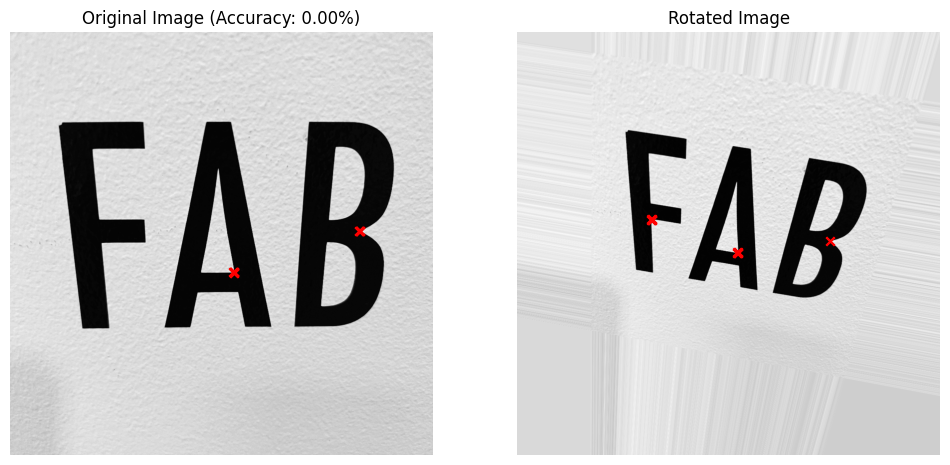

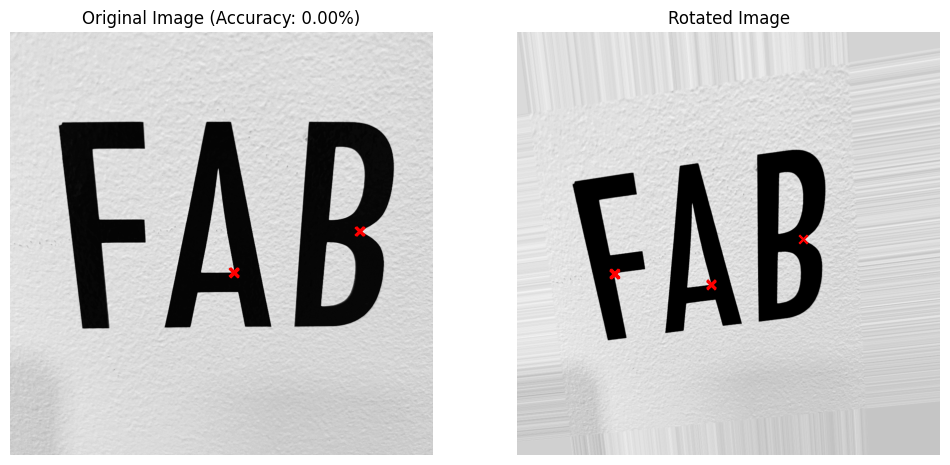

In [185]:
features = 20
threshold = 3
img_iterations('_modified_fab.jpg', dir, features, threshold)

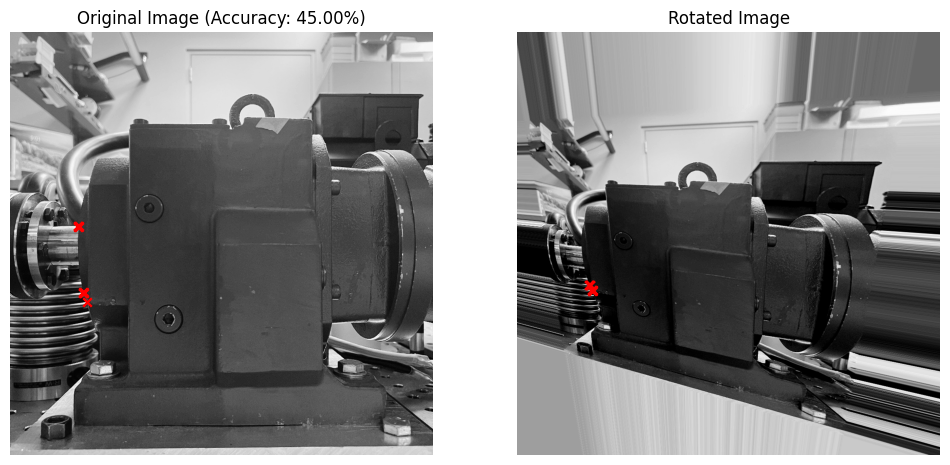

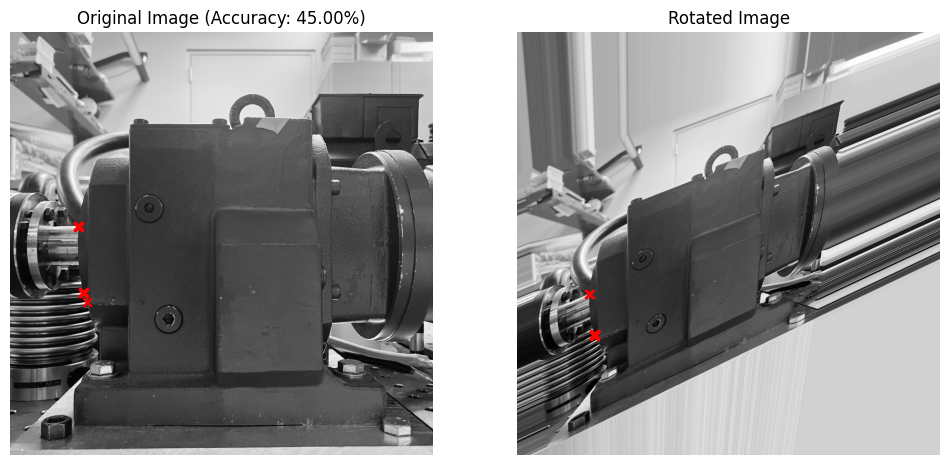

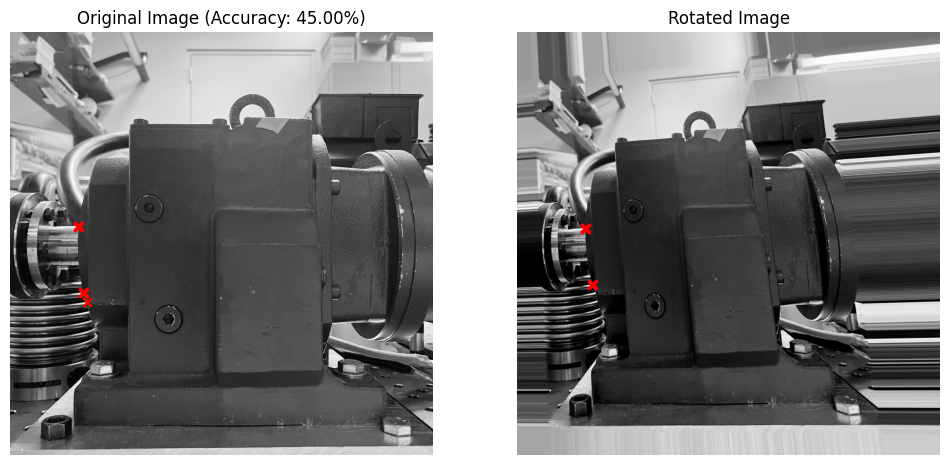

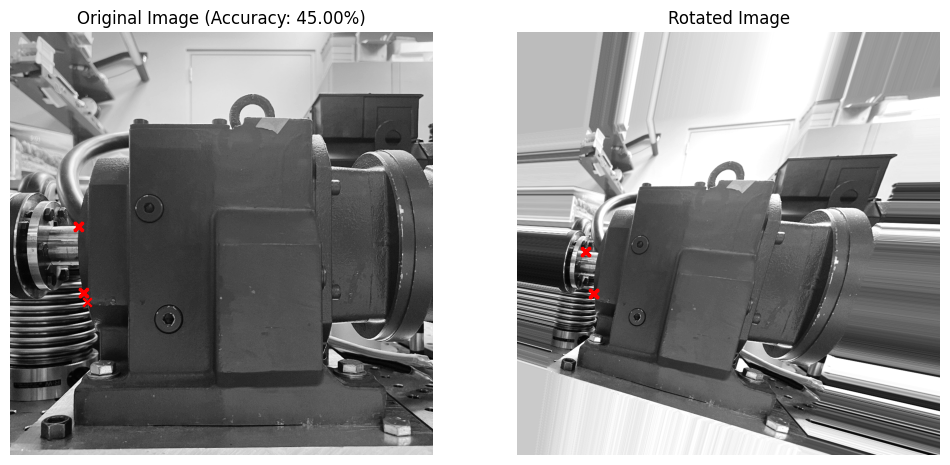

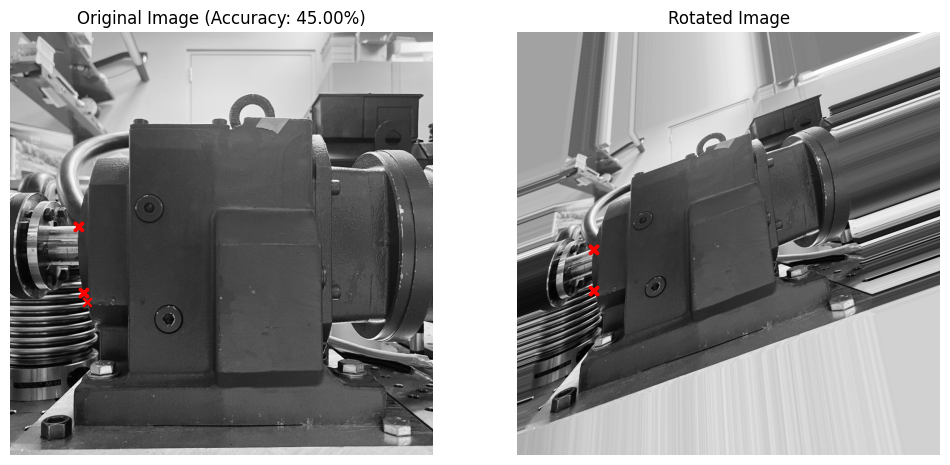

In [186]:
features = 20
threshold = 10
img_iterations('_modified_gearbox.jpg', dir, features, threshold)

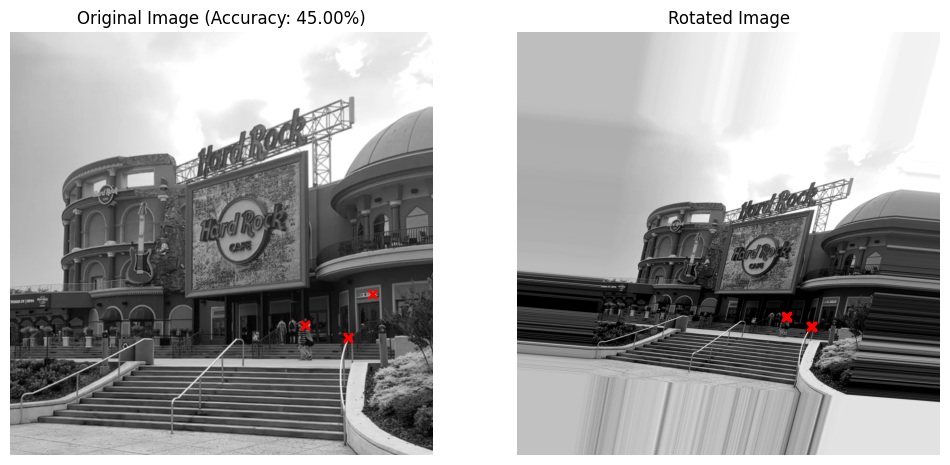

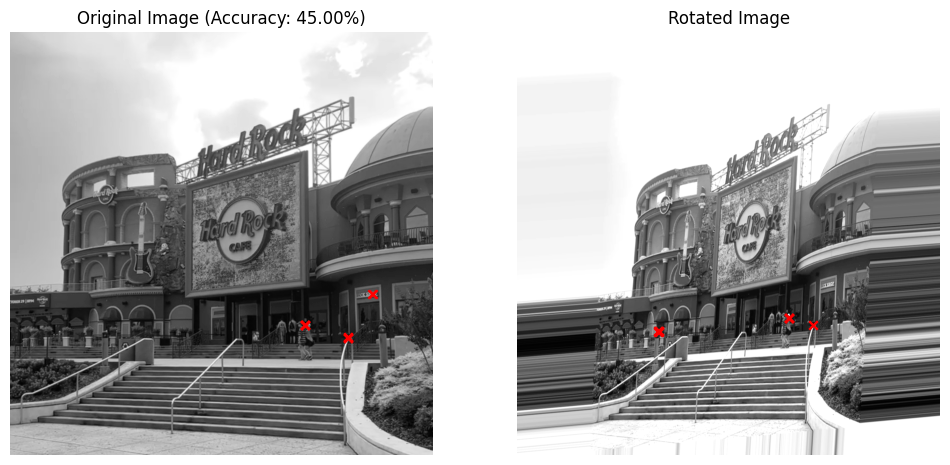

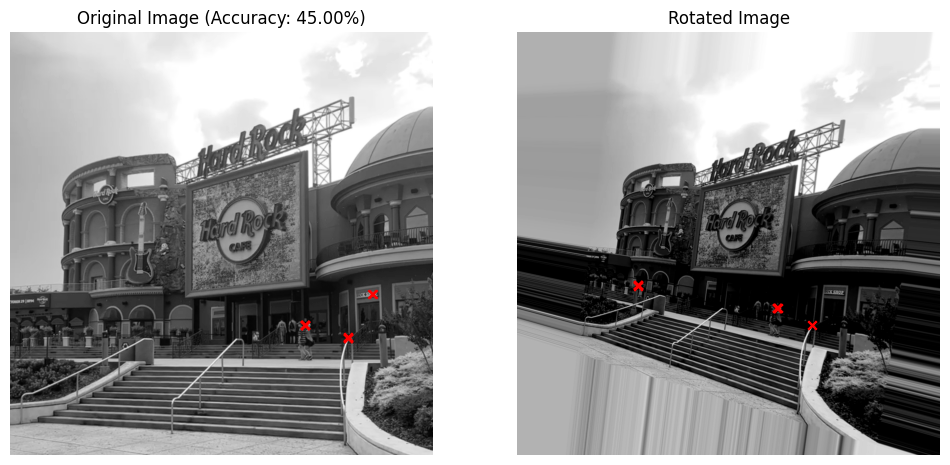

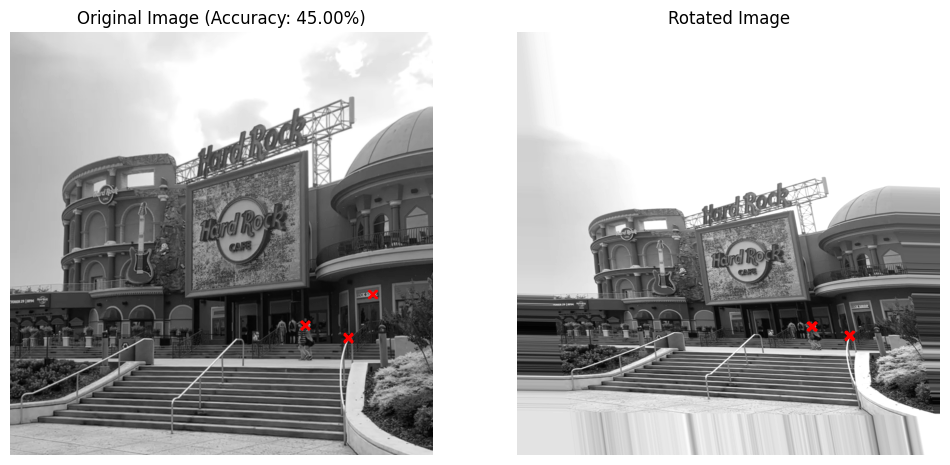

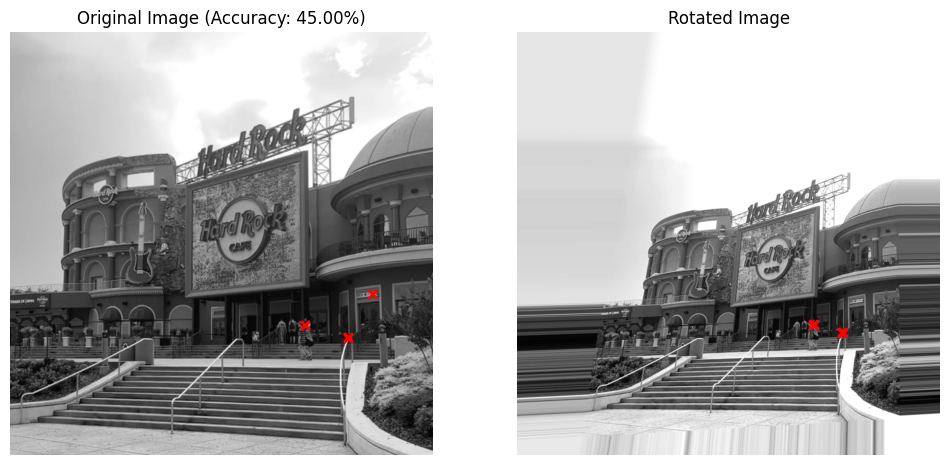

In [187]:
features = 20
threshold = 5
img_iterations('hardrock.jpg', dir, features, threshold)

**Repeat step 3 using SIFT**
---

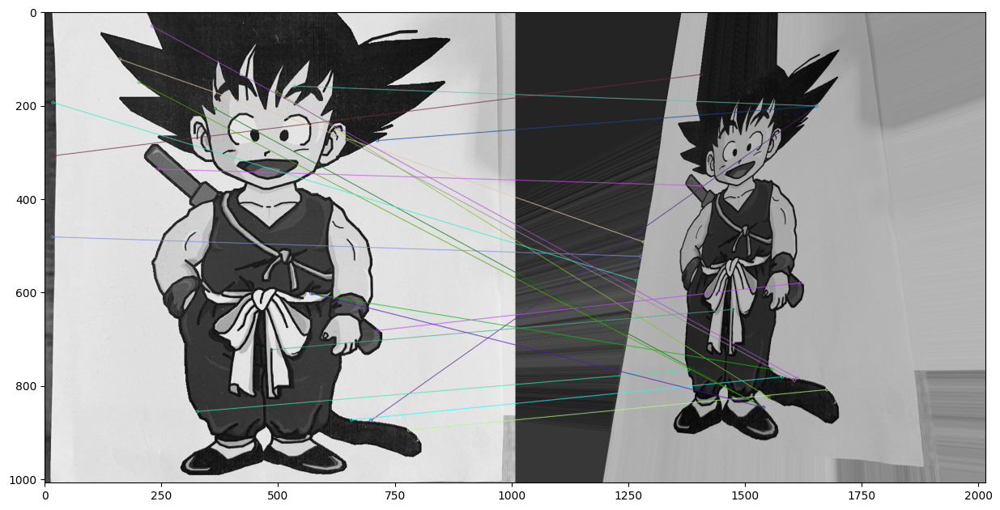

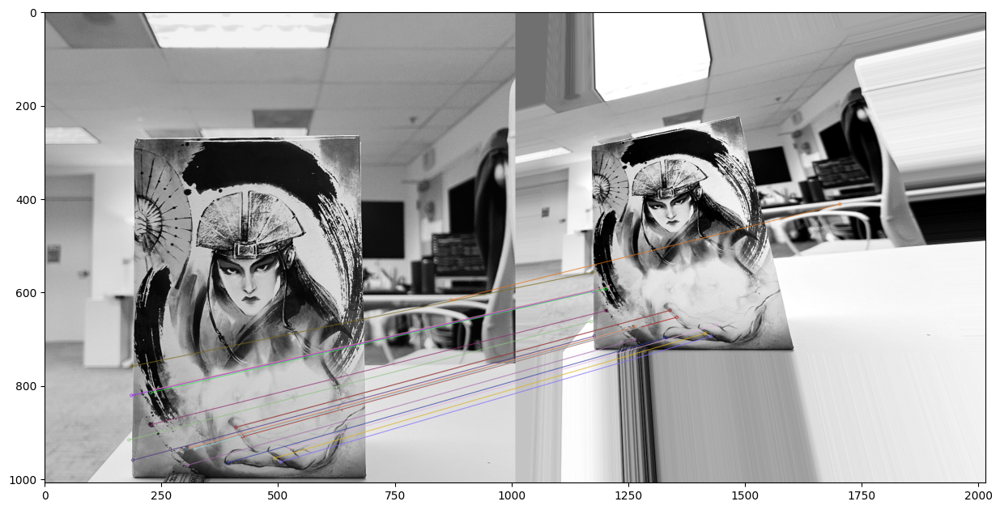

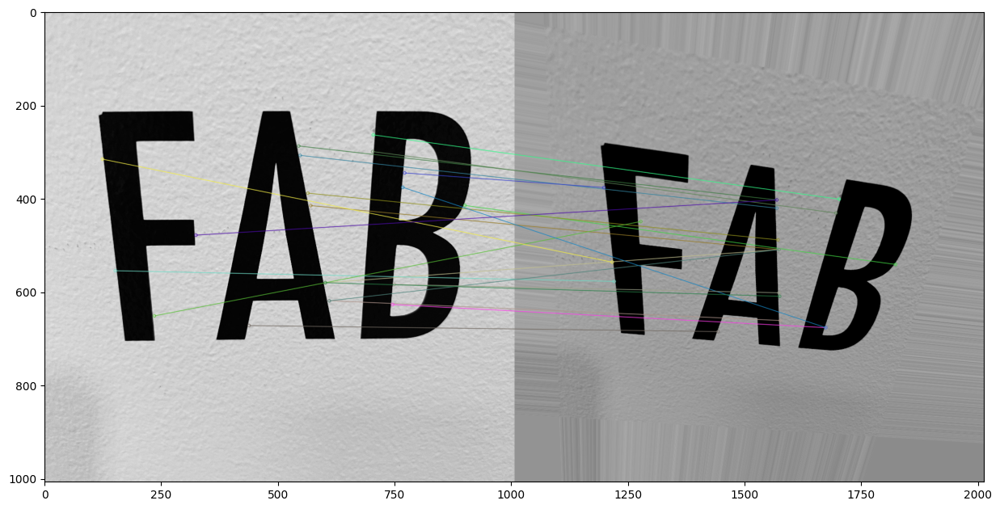

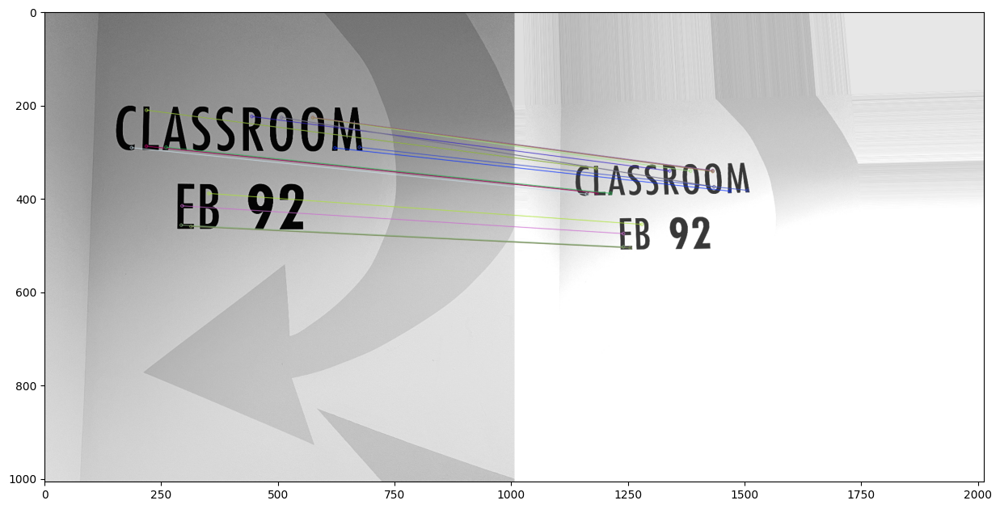

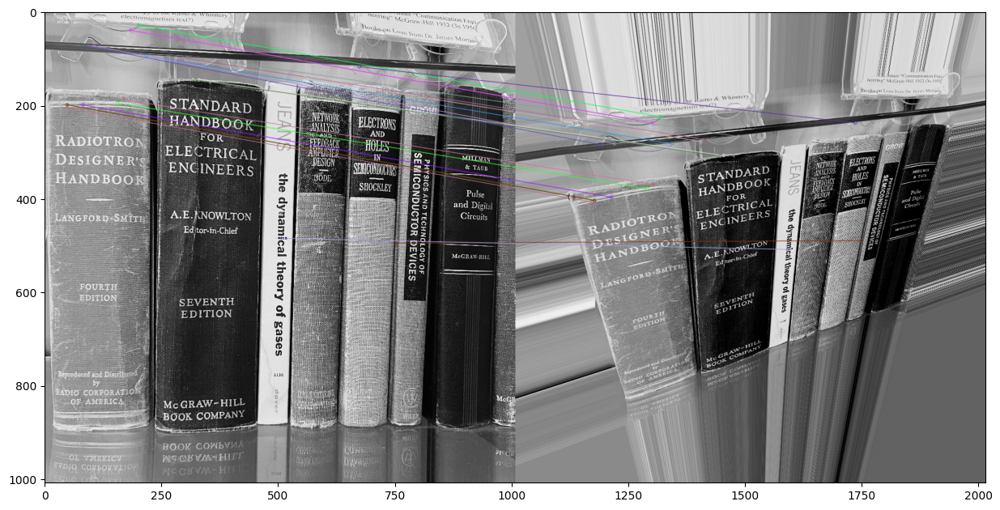

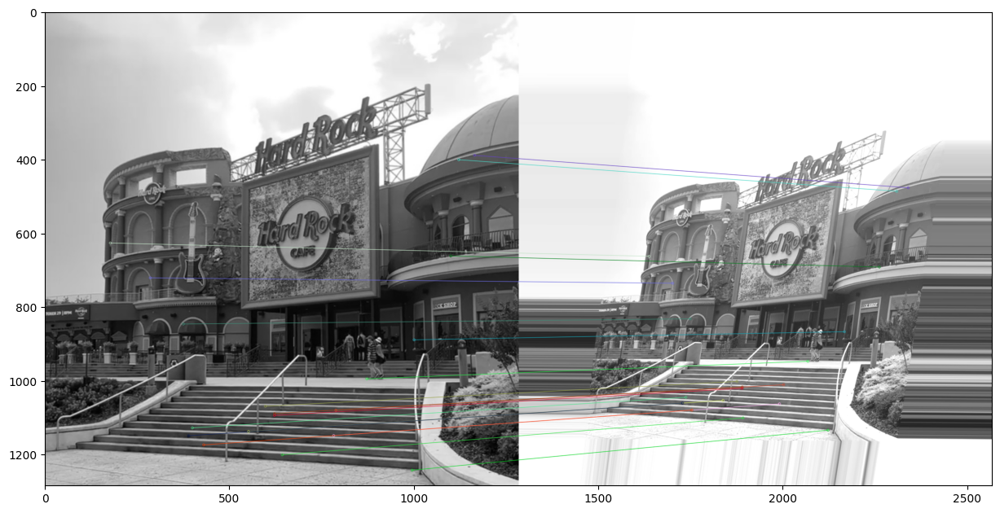

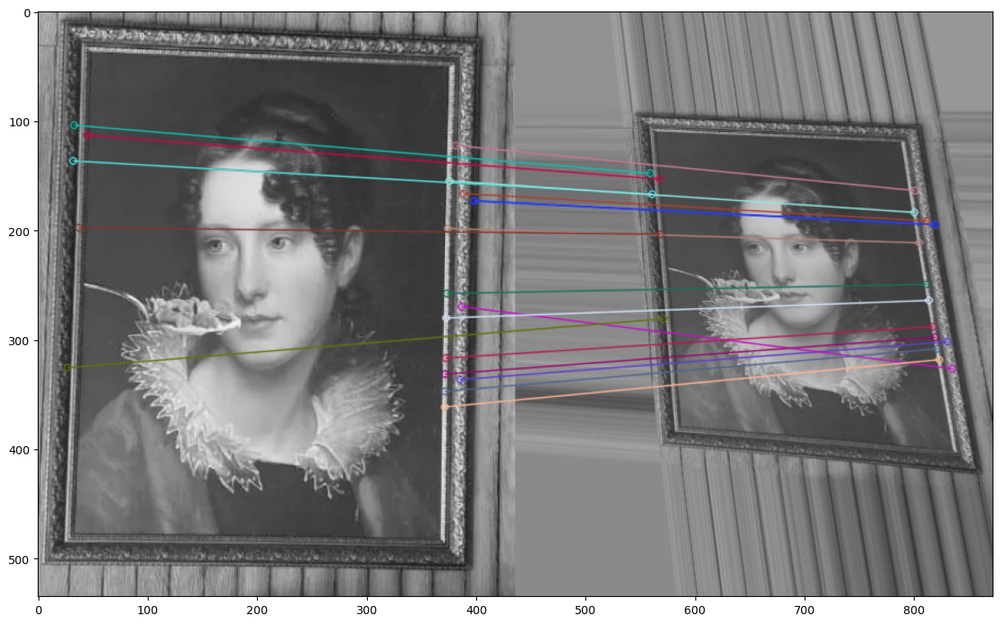

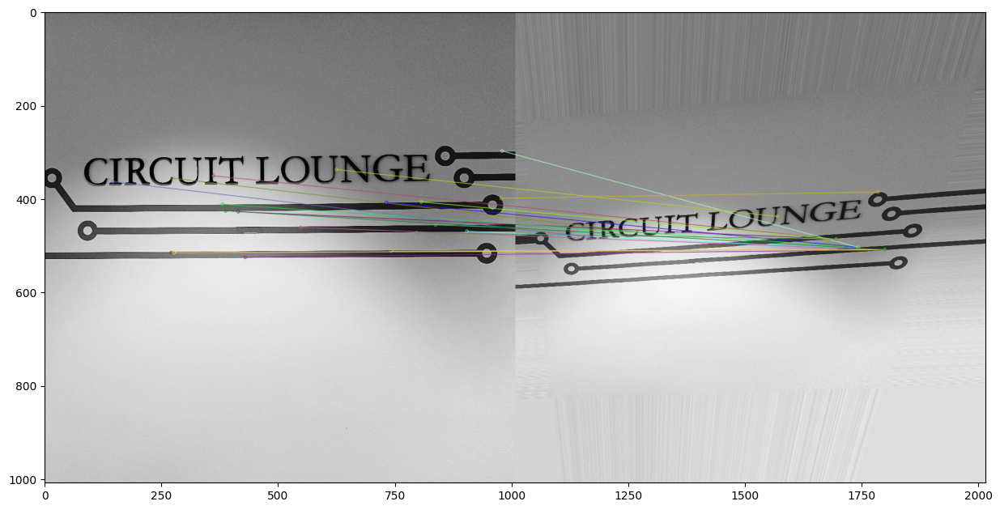

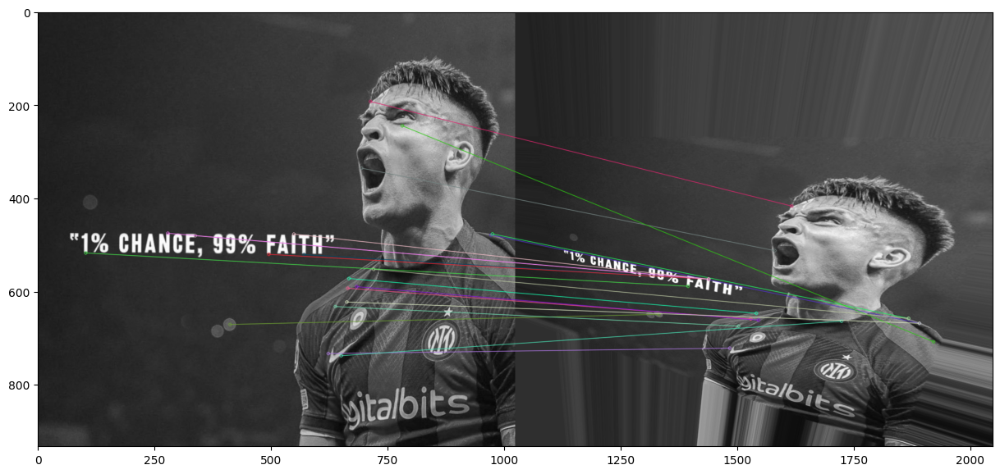

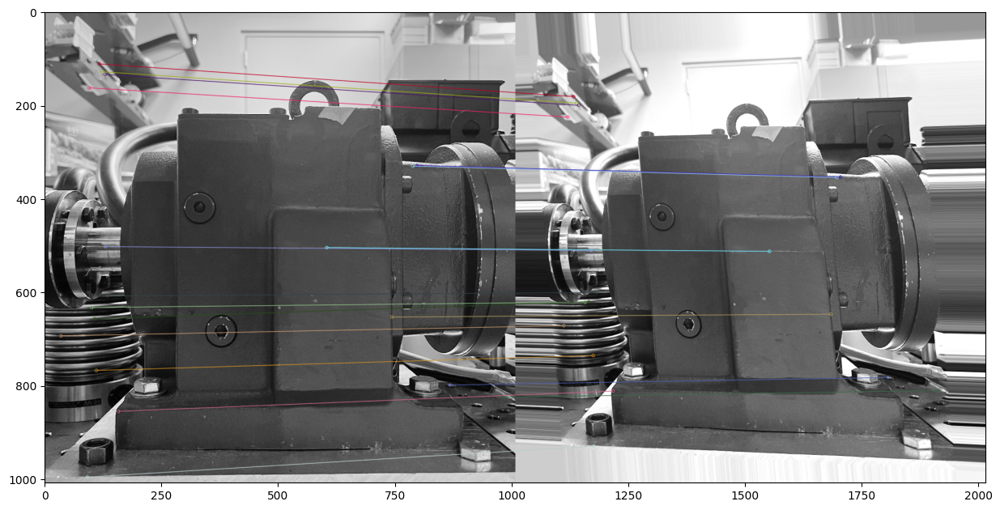

In [164]:
def sift_detector(img, transformed, features):
    sift = cv.SIFT_create()
    orig_kp, desc_orig = sift.detectAndCompute(img, None)

    sift2 = cv.SIFT_create()
    transformed_kp, desc_transformed = sift2.detectAndCompute(transformed, None)

    bf = cv.BFMatcher()
    matches = bf.match(desc_orig, desc_transformed)
    matches = sorted(matches, key=lambda x: x.distance)
    matched_image = cv.drawMatches(img, orig_kp, transformed, transformed_kp, matches[:features], None,
                                   flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

    return matched_image, matches, orig_kp, transformed_kp, desc_orig, desc_transformed

def show_sift_images(img):
    orig, rotat, matrix = rotate_images(img, dir)
    fig, ax = plt.subplots(1, 1, figsize=(15, 10))
    matched_image, matches, orig_kp, transformed_kp, desc_orig, desc_transformed = sift_detector(orig, rotat, features=20)
    ax.imshow(matched_image)

dir = '../../sample_data/new/'
for img in images:
    show_sift_images(img=img)

# def sift_detector (img, transformed, features):
#     sift = cv.SIFT_create()
#     sift2 = cv.SIFT_create()
#     orig_kp, desc_orig = sift.detectAndCompute(img, None)

#     transformed_kp, desc_trnasformed = sift.detectAndCompute(transformed, None)
#     bf = cv.BFMatcher()
#     matches = bf.match(desc_orig, desc_trnasformed)
#     matches = sorted(matches, key = lambda x:x.distance)
#     matched_image = cv.drawMatches(img, orig_kp, transformed,
#                                    transformed_kp, matches[:features], None,
#                                    flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

#     return matched_image, matches, orig_kp, transformed_kp, desc_orig, desc_trnasformed

# def show_sift_images (img):
#     orig, rotat, matrix = rotate_images(img, dir)
#     fig, ax = plt.subplots(1, 1, figsize=(15, 10))
#     matched_image, matches, orig_kp, transformed_kp, desc_orig, desc_trnasformed = sift_detector(orig, rotat, features=20)
#     ax.imshow(matched_image)
# dir = '../../sample_data/new/'
# for img in images:
#     show_sift_images(img=img)

**Repeat step 4 for SIFT where a match is counted if a point is detected within 1 sigma, where sigma is the scale and within 1.41 of the correct scale (just like Lowe did).**
---

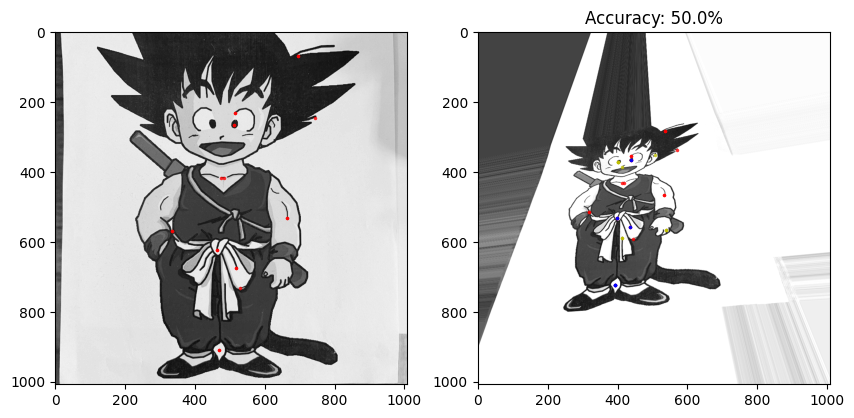

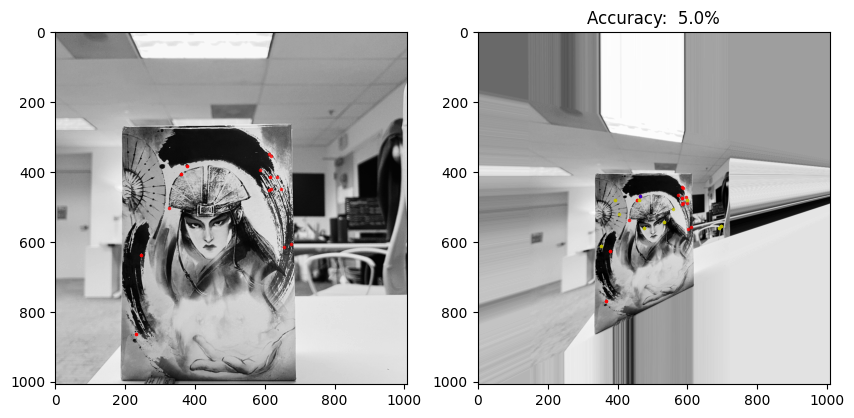

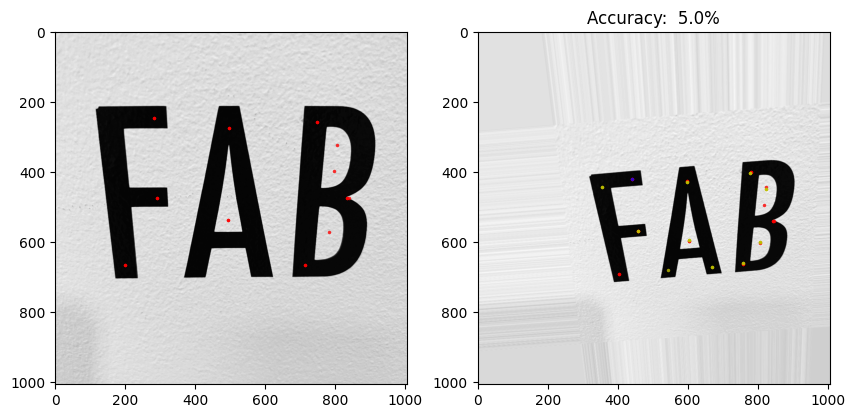

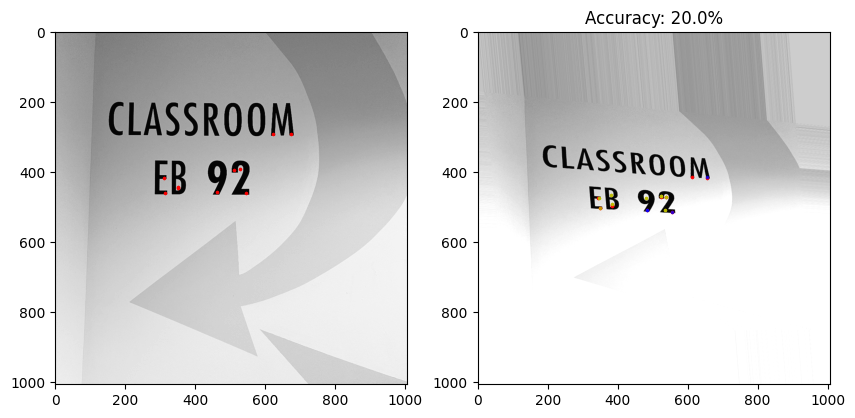

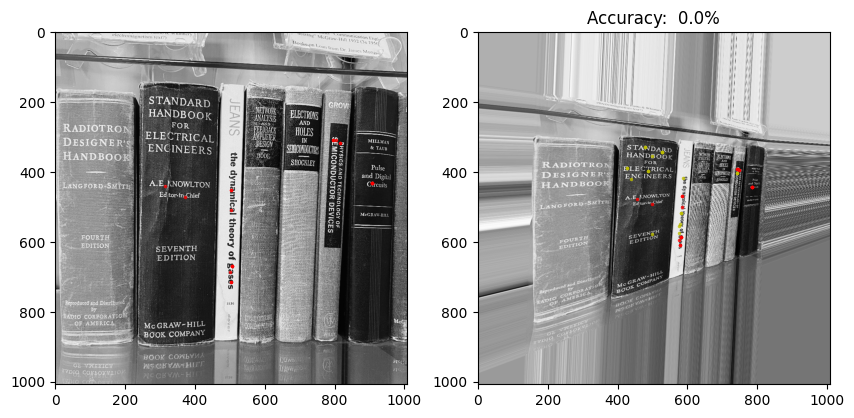

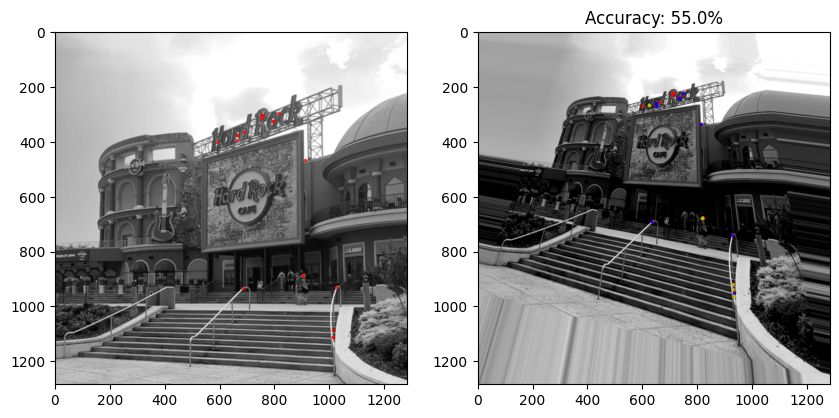

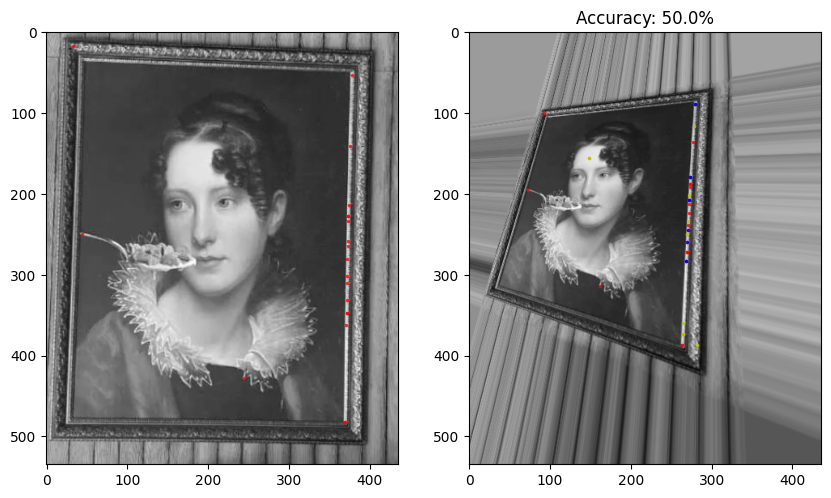

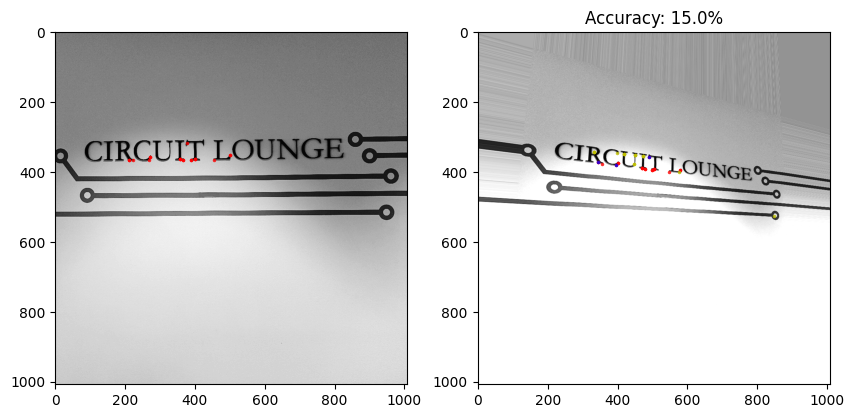

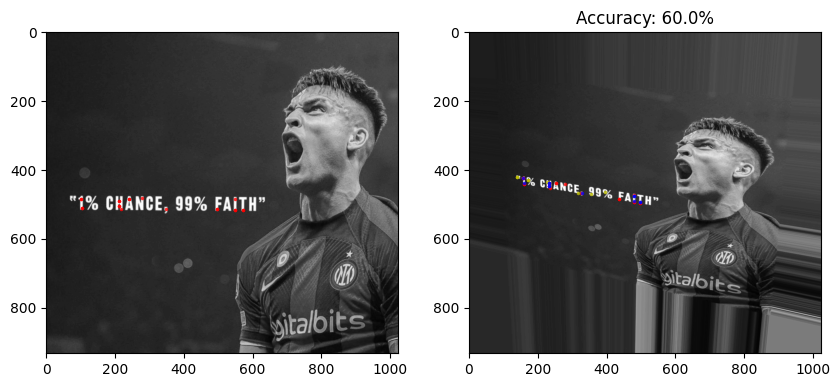

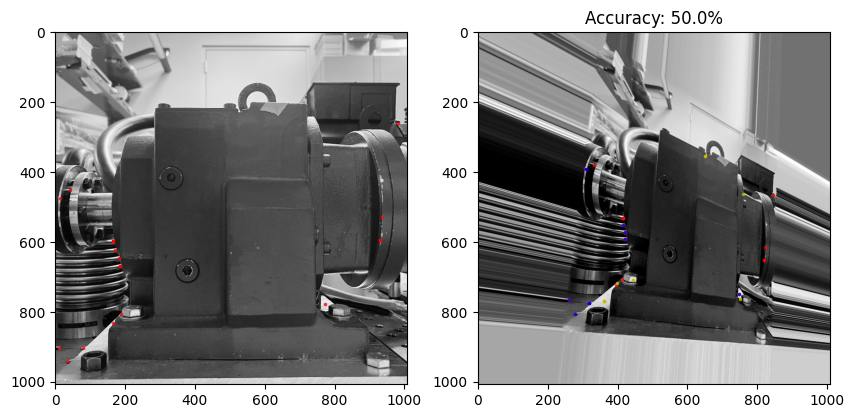

In [175]:
dir = '../../sample_data/new/'
n_features = 20
marker_size = 5

for img in images:
    image, imageTransformed, transform = rotate_images(img, dir)
    sift = cv.SIFT_create()
    sift.setNFeatures(n_features)
    kp = sift.detect(image, None)
    kp = sorted(kp, key=lambda x: -x.response)
    kp = kp[:n_features]
    sift2 = cv.SIFT_create()
    sift2.setNFeatures(n_features)
    kpt = sift2.detect(imageTransformed, None)
    kpt = sorted(kpt, key=lambda x: -x.response)
    kpt = kpt[:n_features]
    figure = plt.figure(figsize=(10, 10))
    axes = figure.add_subplot(1, 2, 1)
    axes.imshow(image, cmap='gray')
    for k in kp:
        x, y = k.pt
        axes.plot(x, y, 'r', marker='.', alpha=0.8, markersize=marker_size, markeredgewidth=0)
    
    axes = figure.add_subplot(1, 2, 2)
    axes.imshow(imageTransformed, cmap='gray')
    
    matches = np.zeros((n_features), dtype=bool)
    for k in kp:
        x, y = k.pt
        xn, yn, l = transform @ np.array([x, y, 1])
        # print(xn,'\t',yn, '\t', l)
        xt = xn/l
        yt = yn/l
        
        # Determine how far the nearest keypoint is from the transformed keypoint
        for c,k2 in enumerate(kpt):
            if matches[c] == True: # If this keypoint has already been matched,
                continue
            x2, y2 = k2.pt
            distance = np.sqrt((x2 - xt)**2 + (y2 - yt)**2)
            if distance<1.41:
                matches[c] = True
        
        axes.plot(xt, yt, 'r', marker='.', alpha=0.8, markersize=marker_size, markeredgewidth=0)
    for c,k2 in enumerate(kpt):
        x, y = k2.pt
        #axes.plot(x, y, 'g', marker='.', alpha=0.8)
        if matches[c] == True:
            axes.plot(x, y, 'b', marker='.', alpha=0.8, markersize=marker_size, markeredgewidth=0)
        else:
            axes.plot(x, y, 'y', marker='.', alpha=0.8, markersize=marker_size, markeredgewidth=0)       
    axes.set_title(f'Accuracy: {np.sum(matches)/n_features*100:4.1f}%')
    
    
    
    

**Which algorithm performed best in your experiments? What are the tradeoffs between these algorithms, based on your experience?**
---

The SIFT performed a lot better than harris. In harris, the corners detection in harris worked fine in both, transformed and original images. Although in the "painting" image, I expected the four corners to be detected, which was not the case with both harris and SIFT. 

Given this conclusion, I think the images with clear corners, such as the painting image, had a low resolution and a lot of noise. I used the gaussian blurr to smooth the image, but the corners would not be detected. Just to be clear, the corners were detected but not within the first 20 prominent features.

I think it is worth mentioning that the most prominent feature in harris, in my opinion, was where the spoon meets the frame. I think both, the SIFT and harris, detected this point correctly, regardless of the number of iterations. 

Further, when I adjusted the number of neighboring pixels to a larger value, the harris did very well. I think that is related to the how the harris works, given that it takes the gradient of pixel intensities within the neighboring pixels.

Overall, I think if I get to choose between the two, I'd go with the harris based on the results of this homework. In the last homework, SIFT performed a lot better than harris. So I think it depends on the application.

**What did you learn from this assignment?**
---

It is a long overdue but I learned how to do the projection matrix by hand. I also learned more about harris corner detection. I still need to work on my SIFT knowledge. 

**What questions do you have for me?**
---

Thank you!

**What would you like to do for your project at the end of this term? Think of the project as taking as much time as two homework assignments.**
---

I want to do a an ASL translation project. In this project, I get to track the hands movement and translates them into letters. I realize that this task maybe complicated, but I will track only one letter. If the hands (or one hand) is shaped like a C, the script would detect it and print the letter C. 

**What do you think you will learn from completing your project?**
---

Objects tracking has been a fun thing to do. I'd learn how to identify hands in a video stream and track the movements of the hands. If the hand is fixed for 10 seconds, then I'll translate that position into a letter. The letter I'm testing is "C" given how simple is it to visualize and implement.